# Visión por Computador - Práctica 3 - Extracción (y Emparejamiento) de Características y Registrado de Imágenes

#### 11 puntos   |   Fecha de entrega: 31 de Diciembre, 23:59   |   Forma de entrega: a través de la tarea creada en https://pradogrado2425.ugr.es/

### Estudiante: <mark>Julio Pérez Cabeza</mark>



<font color='blue'>En esta práctica aprenderás:

<font color='blue'>a) A detectar puntos de interés utilizando el detector de esquinas de Harris (Ejercicio 1).

<font color='blue'>b) A encontrar correspondencias entre los _keypoints_ (puntos de interés) de dos imágenes utilizando distintos descriptores (Ejercicio 2).

<font color='blue'>c) A componer un mosaico/panorama a partir de un conjunto de imágenes utilizando homografías (Ejercicio 3).

In [ ]:
# Let's start importing all background modules
# We start by getting access to the drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys,os
# change directory
%cd '/content/drive/My Drive'
# Let's import the python module exercises.py  to have access to its functions and Classes
get_image = lambda route: os.path.join('/content/drive/MyDrive/images/', route)
import numpy as np
from matplotlib import pyplot as plt
import cv2

Mounted at /content/drive
/content/drive/My Drive


In [ ]:
'''
This function receives a string with the filename of the image to read,
and a flag indicating if we want to read it in color/RGB (flagColor=1) or gray level (flagColor=0)

Example of use:
im1=readIm(get_image('apple.jpg'),0)

'''
def readIm(filename, flagColor=1):
  # cv2 reads BGR format
  im=cv2.imread(filename)
  # change to  RGB and return the image
  if(flagColor):
    return cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  # change from BGR to grayscale instead if flag is 0
  return cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

In [ ]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [ ]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [ ]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

In [ ]:
# Here you include your functions from P1
import math

def GaussFunc(x,sigma):
    return np.exp(-(x**2)/(2*sigma**2))

def GaussDeriv1Func(x,sigma):
    return np.array(((-x)/(sigma**2)) * GaussFunc(x,sigma))

def GaussDeriv2Func(x,sigma):
    return np.array((-1)/(sigma**2) * GaussFunc(x,sigma) + ((-x)/(sigma**2)) * GaussDeriv1Func(x,sigma))

def gaussianMask1D(sigma=0, sizeMask=0, order=0):
    # order = 0 -> función Gaussiana
    # order = 1 -> derivada de la Gaussiana
    # order = 2 -> derivada segunda de la Gaussiana
    if(sigma != 0 and sizeMask == 0):
      # Usamos la función ceiling, que nos coge el siguiente entero por encima, si no es ya un entero
      min_k = math.ceil(3*sigma)
      sizeMask = 2*min_k +1
    elif (sigma == 0 and sizeMask != 0):
      # Calculamos directamente el sigma, dado el sizeMask
      sigma = float((sizeMask - 1)/6.0)
    else:
      raise ValueError("Se debe especificar o sigma o el tamaño de la máscara, no ambas!")
    switch = {
        0: GaussFunc,
        1: GaussDeriv1Func,
        2: GaussDeriv2Func,
    }

    func = switch.get(order, None)

    if func is None:
        raise ValueError("El orden debe ser 0, 1 ó 2!")

    # Calculamos los valores de la máscara usando la función correspondiente
    mask = [func(x, sigma) for x in range(-sizeMask // 2 + 1, sizeMask // 2 + 1)]

    # En caso de ser la gaussiana necesitamos normalizar, dividimos entre la suma de los f(i)
    if (order == 0):
      mask = mask / np.sum(mask)

    # Es importante multiplicar por sigma elevado al orden por temas de escalado
    mask = np.multiply(sigma**order, mask)

    return np.array(mask)

In [ ]:
def my2DConv(im, sigma, orders):
  if orders==[0,0]: # Suavizado Gaussiano
    return cv2.sepFilter2D(im,cv2.CV_64F,gaussianMask1D(sigma=sigma, order = 0), gaussianMask1D(sigma=sigma, order = 0))
  elif orders == [1,0]: # Primera derivada en X
    return cv2.sepFilter2D(im,cv2.CV_64F,gaussianMask1D(sigma=sigma, order = 1), gaussianMask1D(sigma=sigma, order = 0))
  elif orders == [0,1]: # Primera derivada en Y
    return cv2.sepFilter2D(im,cv2.CV_64F,gaussianMask1D(sigma=sigma, order = 0), gaussianMask1D(sigma=sigma, order = 1))
  elif orders == [2,0]: # Segunda derivada en Y
    return cv2.sepFilter2D(im,cv2.CV_64F,gaussianMask1D(sigma=sigma, order = 2), gaussianMask1D(sigma=sigma, order = 0))
  elif orders == [0,2]: # Segunda derivada en Y
    return cv2.sepFilter2D(im,cv2.CV_64F,gaussianMask1D(sigma=sigma, order = 0), gaussianMask1D(sigma=sigma, order = 2))
  else:
    print('error in order of derivative')

# <font color='blue'>**Ejercicio 1:** Harris Corner Detector (3 puntos)

<font color='blue'>Implementar la detección de los 450-500 puntos Harris más fuertes en una imagen (es decir, como mínimo, se deben detectar/mostrar 450 puntos de interés y como máximo 500). Los pasos para implementar el detector de esquinas de Harris son los siguientes: \

> <font color='blue'>a) Fijar las escalas de diferenciación ($\sigma_D$) e integración ($\sigma_I$) en 1.5 y 2.25, respectivamente (aunque también se pueden emplear otros valores de sigma si el estudiante considera que mejoran el rendimiento; esto habría que justificarlo adecuadamente).

> <font color='blue'>b) Calcular las derivadas de la imagen. Para ello, se valorará positivamente el emplear las funciones creadas por el propio alumnado (en lugar de emplear directamente _cv2.getDerivKernels()_, _cv2.GaussianBlur()_, _cv2.filter2D()_ y similares).

> <font color='blue'>c) Calcular los tres términos de la _Second Moment Matrix_ ($SMM$) en cada píxel. Para ello, aplicar convolución con una máscara gaussiana con $\sigma_I$.

> <font color='blue'>d) A partir de la $SMM$, calcular el valor de Harris en cada píxel de la imagen.

> <font color='blue'>e) Aplique la supresión de no máximos mediante la función `corner_peaks()` (https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks) del módulo `skimage.features`. El estudiante debe seleccionar una `min_distance` adecuada (`The minimal allowed distance separating peaks`) y un umbral de respuesta adecuado en el mapa de Harris para mantener solo la cantidad de _keypoints_ que se solicitan en el enunciado. El resultado será una lista de coordenadas $(x,y)$. Extraiga los valores en estas coordenadas y cree una lista de vectores $(x,y,value)$.

> <font color='blue'>f) Calcule la orientación principal para cada punto. Esto se hace suavizando ambas imágenes derivadas con un sigma suficientemente grande ($\sigma=3$) y, a continuación, calculando la orientación del gradiente en esos puntos.

> <font color='blue'>g) Cree una lista de _keypoints_ usando los puntos seleccionados. Un _keypoint_ suele representarse como un vector que incluye distintos elementos, por ejemplo, $(x,y,scale,orientation)$. En nuestro caso, un _keypoint_ es una estructura de OpenCV (`cv2.KeyPoint`), asociada a cada región detectada, que contendrá las coordenadas $x$ e $y$ del _keypoint_, así como su tamaño ($size$, es decir, el diámetro con el que se va a mostrar) y su orientacion ($angle$, calculada en el paso anterior). El parámetro $size$ de _KeyPoint()_, es decir, el diámetro del _keypoint_ mostrado, debe ser suficientemente grande como para ser visualizado adecuadamente. Una posibilidad es emplear `size=4*np.floor(3*sigmaI)+1`

> <font color='blue'>h) Dibuje los puntos sobre la imagen de entrada usando la función `drawKeyPoints()` (https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920), y los _flags_ `cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

<font color='blue'>Se deben calcular los puntos de Harris sobre la imagen `IMG_20220312_102944_S.jpg`, y se debe mostrar:
* <font color='blue'>El mapa de respuestas de Harris (valor de Harris) en cada píxel de la imagen,
* <font color='blue'>el mapa de Harris umbralizado, es decir, una vez aplicado supresión de no máximos y un umbral mínimo de respuesta adecuado para obtener el número de puntos de interés solicitados,
* <font color='blue'>y la imagen de entrada con los keypoints finales, junto con el número exacto de _keypoints_ detectados (es decir, es necesario hacer un `print()` con el número de puntos de Harris).





TODO: Umbralized dejarlo bien, comentar conclusiones finales

Comenzamos con la explicación de Harris, detector de esquinas para ir incorporando su implementación poco a poco. El esquema que seguiremos será el de ir comentando sobre su funcionamiento a la vez que se va añadiendo el código necesario para entenderlo.

**¿Qué es Harris Corner Detection y cómo funciona?**

Nos adentramos en la última práctica de la asignatura, que es la más geométrica de todas, y por ello, implementaremos un detector de esquinas. Las aplicaciones de esto van desde el seguimiento de objetos a la reconstrucción 3D, por lo que lo convierte en un potente algoritmo y nos hace reflexionar sobre la importancia de estos aspectos más geométricos y matemáticos, en comparación a la práctica anterior de Deep Learning. **!No todo sobre Visión por Computador es acerca de las redes neuronales convolucionales!**

<center><img src = https://miro.medium.com/v2/resize:fit:640/0*JUpRtT3SAU1HQmL9.jpg height = '250'></center>

> 📝Los puntos significativos de la imagen se resaltan. El algoritmo nos permitirá encontrar siempre puntos de interés de una imagen, que serán equivariantes a traslaciones y rotaciones. Imagen extraída de [https://medium.com/@deepanshut041/introduction-to-harris-corner-detector-32a88850b3f6]

Es un algoritmo clásico, que se usa para encontrar y detectar zonas o esquinas significativas. El primer punto que se nos plantea es el siguiente:

**¿Qué entendemos por esquina?**

Por muy básica que resulte la pregunta, es necesario plantear la pregunta y entender qué consideramos como esquina, en el ámbito discreto de píxeles de una imagen.

Ya veíamos en la primera práctica que se pueden implementar derivadas de una imagen, y por tanto su gradiente. Una esquina será un punto de la imagen donde los gradientes cambian significativamente en ambas direcciones, en el eje X y en el eje Y. La motivación de esto se resume en la siguiente imagen, discutida en teoría y en prácticas:

<center><img src = https://www.researchgate.net/profile/B-T-Murthy/publication/322517116/figure/fig2/AS:902341800775684@1592146458964/The-basic-idea-of-Harris-corner-detector.jpg height = '200'></center>

> 📝Las zonas planas no presentan cambios en ninguna de las direcciones que nos movamos. Los bordes, si nos movemos justamente en su dirección tampoco cambian. En contraste, las esquinas cambian en cualquiera de las direcciones que nos movamos. Imagen extraída de [https://www.researchgate.net/figure/The-basic-idea-of-Harris-corner-detector_fig2_322517116]

Para trabajar con este concepto de cambio en la dirección de X o de Y, generaremos la **matriz de segundo orden o SMM**. Por cómo se define, la matriz representa las diferencias de intensidad en todas las direcciones resultantes de ir deslizando una ventana (como la de la imagen anterior) por la imagen, píxel a píxel. Además, cada derivada se pondera en función a la distancia de cada píxel al centro de la imagen (ventana gaussiana). Se define como:

$$
H = \sum_{(x,y) \in W} w_{x,y}
\begin{bmatrix}
I_x^2 & I_x I_y \\
I_x I_y & I_y^2
\end{bmatrix}
$$

* Donde $w_{x,y}$ es la ventana.
* $I_x$ es la derivada de la intensidad respecto de $x$, $I_y$ respecto de $y$.

En la práctica, lo que tendremos será, una matriz con 3 imágenes (correspondientes a $I_x^2$, $I_y^2$ y $I_xI_y$) y hacer una convolución de todas ellas con un filtro gaussiano ($\sigma$ elegido por nosotros).

$$$$

**¿Qué información extraemos de esta matriz?**

Nos permite calcular la $f_H$ o *scalar cornerness* que es una medida para identificar las esquinas. Esta se calcula como:

$$f_h = \frac{det(H)}{traza(H)}$$

Como se nos indica en el enunciado, hemos de usar **escalas de diferenciación y de integración**. Estas determinarán:

* Factor de diferenciación $\sigma_D$: Determina el suavizado previo al cálculo de las derivadas.

$$
H =
\begin{bmatrix}
I_x^2(\sigma_D) & I_x I_y(\sigma_D) \\
I_x I_y(\sigma_D) & I_y^2(\sigma_D)
\end{bmatrix}
$$

* Factor de integración $\sigma_I$: Suavizado posterior de toda la matriz.

$$
H = g(\sigma_I) *
\begin{bmatrix}
I_x^2 & I_x I_y \\
I_x I_y & I_y^2
\end{bmatrix}
$$

$$$$

**Pequeña intuición matemática sobre lo que se va a hacer**

La matriz $H$ que hemos definido, es simétrica y tiene una descomposición de la forma $H = UAU^T$(ver material complementario sobre *eigenvalues*). $A$ también es una matriz simétrica, que contiene los eigenvalues de $H$. ¿Qué información nos dan estos valores?

> "An eigenvector is a vector that does not change direction".

<center><img src = https://cdn1.byjus.com/wp-content/uploads/2021/03/Eigenvalue-Example.png height = '200'></center>

Es decir, nos ayudan a entender el comportamiento de transformaciones lineales, como puede ser la construcción de $H$. De esta manera, si controlamos y entendemos estos vectores y valores, podemos caracterizar y entender el comportamiento del error $E(u,v)$ que definíamos en teoría para Harris.

Así, si tenemos los eigenvalues para $A$, estos nos proporcionan:

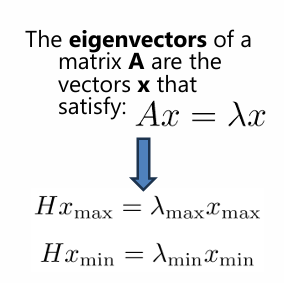

Donde $\lambda_{max}$ representa el aumento en la dirección de $x_{max}$ y $\lambda_{min}$ el descenso en la dirección de $x_{min}$. Estos valores caracterizan así un punto de la imagen. Distinguimos:

* Si los valores encontrados son ambos pequeños, estamos en una *flat region*.
* Si uno es más grande que otro, estamos en un borde.
* Si los dos son grandes, estamos en una esquina o **corner**.

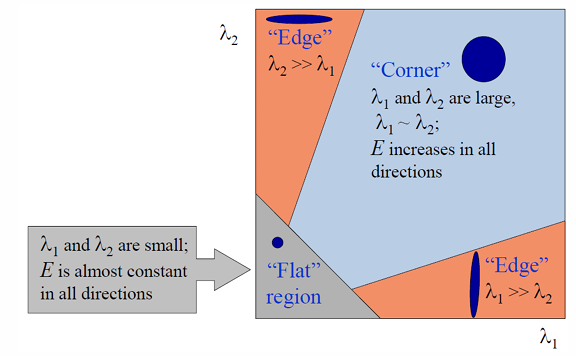
$$$$
Tras este paréntesis matemático, continuamos con la **implementación**. Para nuestra práctica, usaremos los valores $1.5$ y $2.25 ≈ 1.5 \cdot \sigma_D$, respectivamente. Al valor $f_H$, también se le llama **Mapa de Harris**. Estamos en condiciones de implementar entonces lo discutido hasta ahora.


In [ ]:
# Compute image derivatives
def derivatives(im,sigmaD = 1.5):
  im = im.astype(np.float32)
  dx = my2DConv(im, sigmaD, [1,0])
  dy = my2DConv(im, sigmaD, [0,1])

  return dx,dy

# Compute Harris-criterium Map
def HarrisMap(dx,dy,sigmaI = 2.25):

  Ix = my2DConv(dx**2, sigmaI, [0,0])
  Iy = my2DConv(dy**2, sigmaI, [0,0])
  IxIy = my2DConv(dx * dy, sigmaI, [0,0])

  det = Ix * Iy - IxIy**2
  trace = Ix + Iy

  return det / trace

El siguiente paso del algoritmo es **Non Maxima Supression**. Deslizaremos una ventana por la matriz **H** resultante de los pasos anteriores. Esta técnica es sencilla: para cada posición, eliminaremos el píxel central de la ventana si NO es el máximo dentro de la ventana. En caso contrario, no lo eliminamos. Así nos quedamos con valores máximos en un vecindario. Es importante discutir los parámetros de la función `corner_peaks()`:

* `min_distance`: La distancia mínima que tiene que existir entre los puntos.
* `threshold_abs`: La intensidad mínima que deben tener los puntos encontrados. De esta manera filtramos las respuestas de intensidad baja pues buscamos altos valores para $f_H$.

Es muy importante su elección pues queremos extraer entre 450 y 500 puntos, pues así se nos pide en el enunciado. La discutiremos más adelante.

> 📝Ver la documentación oficial [https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks]

In [ ]:
def NonMaximaSuppression(harrisMap, min_distance, threshold):

  corners = corner_peaks(harrisMap, min_distance, threshold_abs = threshold)
  values = [harrisMap[p[0], p[1]] for p in corners]

  return corners, values

**¿Qué tenemos hasta ahora?**
De lo anterior extraemos entonces una serie de puntos $(x, y, valor)$, que representan las coordenadas de los píxeles encontrados tras aplicar Non Maxima Supression, junto a su valor $f_H$. Hasta ahora, tenemos implementado hasta el punto e) del enunciado.

$$$$

Ahora, hemos de calcular la orientación de todos los puntos de interés anteriores. Para ello, primero se hace un suavizado en ambas direcciones (con $\sigma = 3$) y después se calcula la orientación del gradiente (como hacíamos en la P1) usando la fórmula:

$$\theta = \frac{\arctan\left(\frac{\text{smooth}(dy)}{\text{smooth}(dx)}\right) \cdot 180}{\pi}$$

In [ ]:
def orientation(dx,dy):
  smooth_dx = my2DConv(dx, 3.0, [0,0])
  smooth_dy = my2DConv(dy, 3.0, [0,0])

  # np.arctan2(dy/dx) como hacíamos en la P1
  theta = np.arctan2(smooth_dy, smooth_dx) * (180 / np.pi)
  return theta

def keyPoints(coord,theta,size):
  keyPoints = []
  # Para cada punto de interés, crearemos un keypoint con su size, orientacion y coordenadas
  for p in coord:
    angle = theta[p[0], p[1]]
    kp = cv2.KeyPoint(float(p[1]), float(p[0]), float(size), angle)
    keyPoints.append(kp)

  return (keyPoints)

Con la orientación implementada, solo nos falta la **creación de una lista de keypoints** con los elementos descritos a continuación. Haremos uso de los objetos `cv2.KeyPoint`:

* Coordenadas, de los puntos encontrados previamente
* Orientación, calculada para cada una de las coordenadas
* `Size` o tamaño del radio a usar en la visualización. Para una correcta visualización del mismo, usaremos la indicación dada en el enunciado `size = 4 * np.floor(3 * 2.25) + 1`.

$$$$

Vamos con la visualización de lo pedido:

**Elección de `min_distance` y `threshold_abs`**
Tras varias pruebas, se decide usar los siguientes valores, que nos proporcionan un **total de 492 keypoints**:
* Usaremos `min_distance = 1`, pues la imagen parece tener esquinas bastante cercanas entre ellas, por lo que no aumentaremos más la distancia entre corners.
* Para `threshold` tomaremos el valor de **1600**, quedándonos así con los puntos de interés más relevantes.

Con esta combinación de parámetros, obtenemos el número de keypoints deseados pues se nos pide que esté entre 450-500.


#####**Visualización de Harris Map**

Para la visualización del Harris Map, se hará uso de `displayIm()`, dada por el profesor para la visualización de imágenes. Por tanto solo debemos llamar a las funciones creadas anteriormente:

* Calculamos derivadas `derivatives(im)` (en blanco y negro, solo buscamos cambios de intensidad).
* Computamos el mapa de Harris `HarrisMap(dx, dy)`.
* Aplicamos `NonMaximSuppression(harrisMap, 1, 1600)` con los parámetros discutidos.
* Visualizamos.

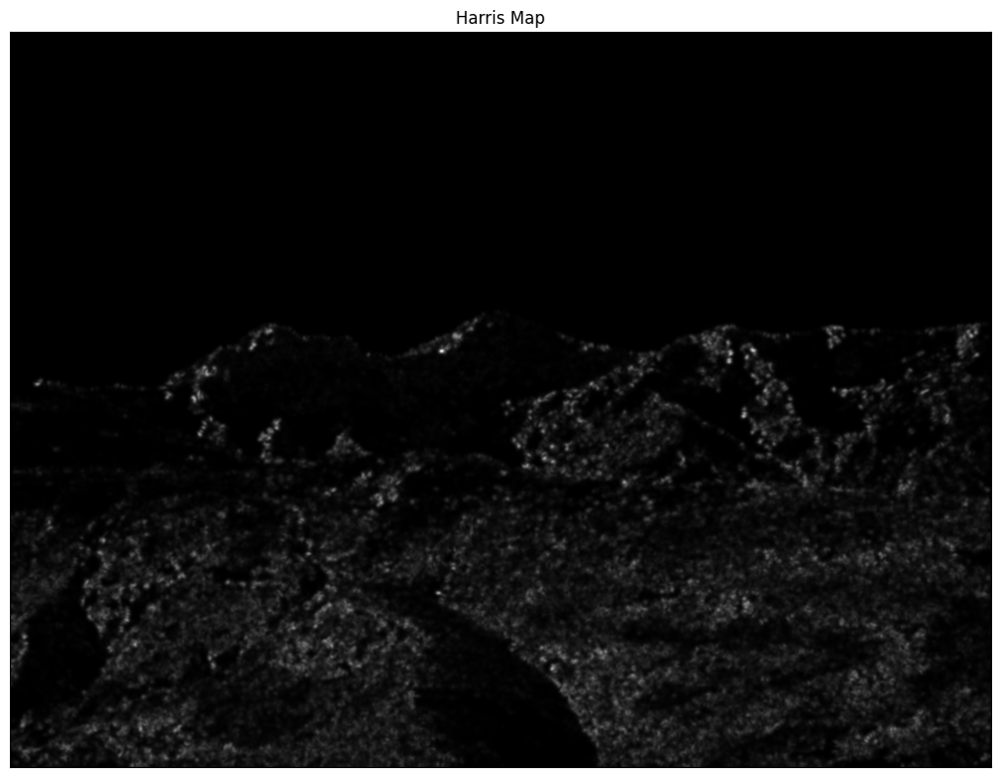

In [ ]:
from skimage.feature import corner_peaks
img = readIm(get_image('IMG_20220312_102944_S.jpg'),1)
im = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
dx, dy = derivatives(im)

harrisMap = HarrisMap(dx, dy)

displayIm(harrisMap,'Harris Map', 2)

Como veíamos en clase de teoría, la respuesta de la detección se interpreta con **las zonas blancas de la imagen como las esquinas** que se han detectado. En negro, el resto de la imagen donde no se ha detectado ninguna esquina. (Concuerda con la ubicación espacial de las montañas en la imagen original)

#####**Visualización de Harris Map Thresholded**

Se nos pide visualizar el mapa de Harris umbralizado. Para ello, se ha de aplicar `NonMaximaSuppression()`. Como realmente este método solo nos devuelve los puntos de interés que buscamos, y no el mapa de Harris Modificado;

> "Find peaks in corner measure response image."

Lo que podemos hacer es partir del mapa de Harris anterior, y umbralizarlo nosotros. Es decir, quedarnos con los puntos que tengan intensidad mayor que el `threshold` que hemos escogido. Para ello, definimos la función siguiente `thresholdImg()`, que aprovecha las funcionalidades de *Numpy* devolviendo los índices donde el mapa de Harris tiene valores menores que el `threshold, 1600` y los pone a 0 (negro).

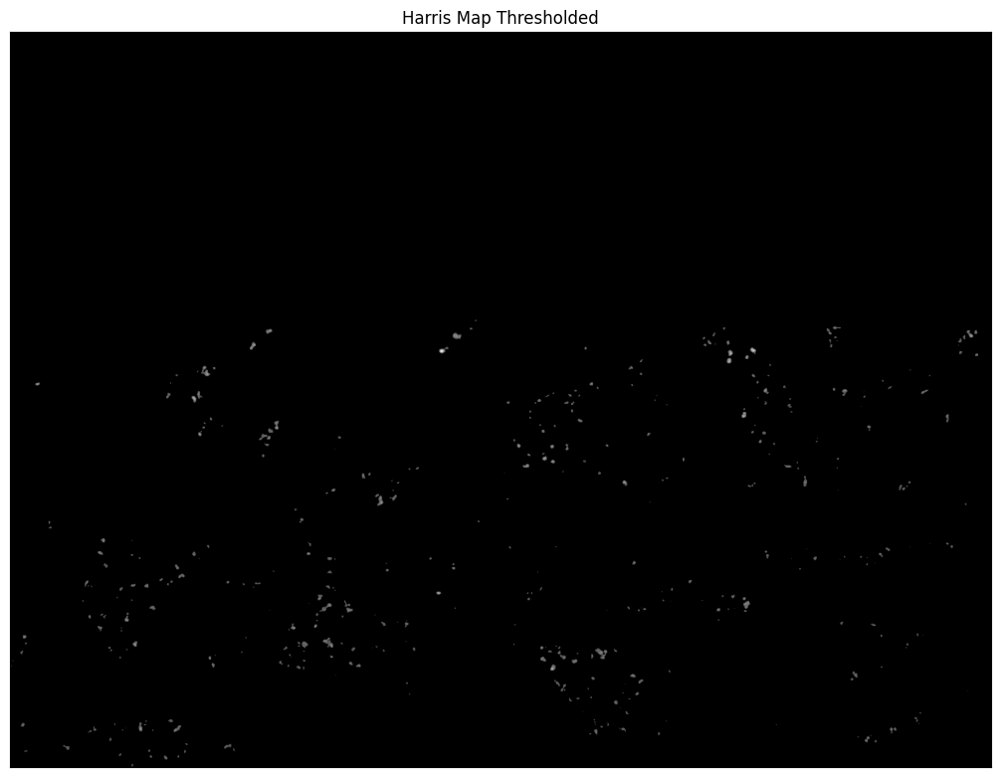

In [ ]:
corners, values = NonMaximaSuppression(harrisMap, 1, 1600)  # min_distance y threshold_abs

harrisMap2 = harrisMap.copy()
harrisMap2[harrisMap2 < 1600] = 0.0

displayIm(harrisMap2,'Harris Map Thresholded',2)

Observamos en esta nueva visualización que perdemos una gran cantidad de puntos. Esto tiene sentido pues estamos filtrando todos los puntos de interés a únicamente los

#####**Visualización de los keypoints en la imagen original**

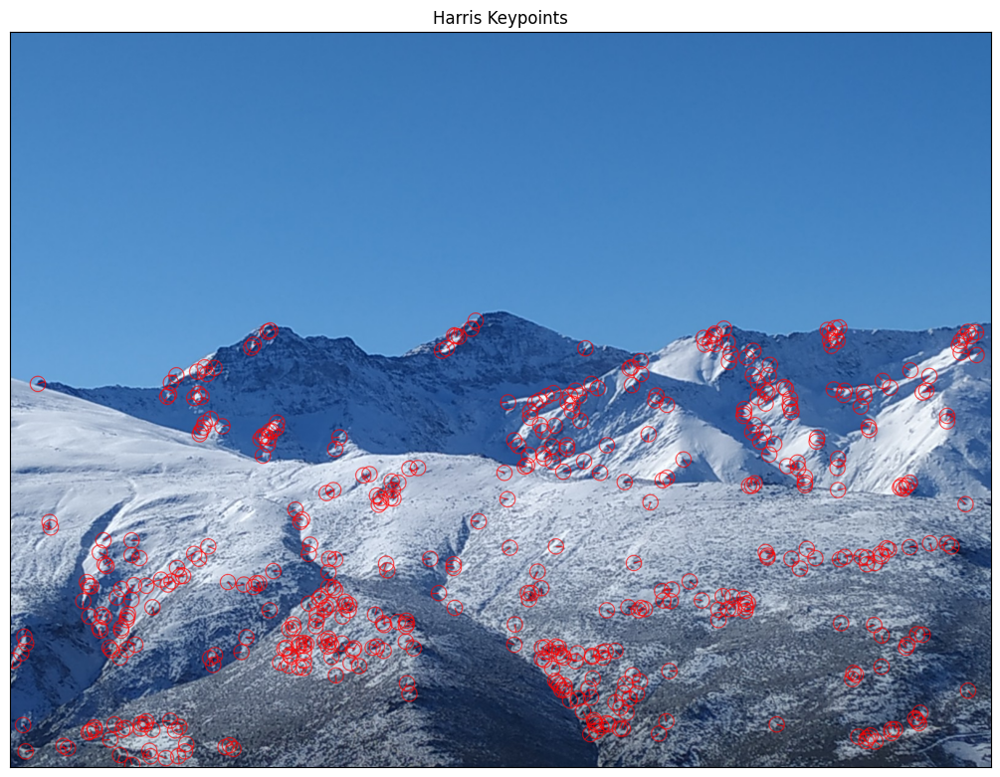

Número de keypoints finales detectados por Harris:  492


In [ ]:
theta = orientation(dx, dy)

size = 4 * np.floor(3*2.25) + 1

keypoints = keyPoints(corners, theta, size)
flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS | cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG
harrisKeypoints = cv2.drawKeypoints(img, keypoints, img.copy(), color=(255,0,0), flags=flags)
displayIm(harrisKeypoints,'Harris Keypoints',2)
print('Número de keypoints finales detectados por Harris: ', len(keypoints))

**¿Qué desventajas tiene?**

El detector de Harris no es invariante a cambios de escala. Esto significa que si la imagen o los objetos dentro de la imagen cambian de tamaño (por ejemplo, al acercarse o alejarse), es posible que el algoritmo no detecte las mismas esquinas. Esto tiene sentido, pues:

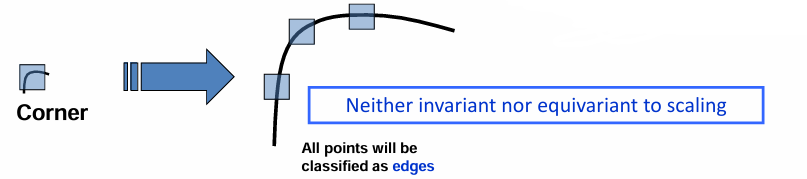

Aunque Harris es un buen punto de partida por su simplicidad y efectividad, sus limitaciones lo hacen menos adecuado para aplicaciones avanzadas, como se discutió en clase. Esto motiva el uso de SIFT (Scale Invariante Feature Transform) que discutiremos en el siguiente ejercicio.

Aún así, vemos que los resultados son razonablemente buenos, pues a nivel geométrico ha detectado, al menos a simple vista, puntos que parecen esquinas, sobre todo de la montaña. La naturaleza de la montaña, al ser rocosa, hace que aparezcan tantas esquinas.

# <font color='blue'>**Ejercicio 2:** Emparejamiento de _keypoints_ entre imágenes usando descriptores SIFT, HOG y LBP (3 puntos)

<font color='blue'>En este apartado, partiendo de un detector de características (SIFT) y tres descriptores de características (SIFT, HOG y LBP), vamos a calcular el emparejamiento entre _keypoints_ de dos imágenes. Las imágenes con las que se trabajará en este ejercicio serán `IMG_20220312_102940_S.jpg` y `IMG_20220312_102944_S.jpg`. Estas imágenes son de $1200\times1600$ pero, tras leerlas, se debe reducir su tamaño a la mitad ($600\times800$). Es en esta última dimensionalidad en la que realizaremos todo el ejercicio y visualizaremos las imágenes. Y, a continuación, debemos pasarlas a escala de grises. Nota importante: del mismo modo que se calculan _keypoints_ y descriptores en escala de grises, luego los matches/emparejamientos sí se visualizan sobre las imágenes originales en color.

## <font color='blue'>SIFT (Scale-invariant feature transform)

<font color='blue'>En un primer momento, el alumnado debe aplicar el algoritmo SIFT a ambas imágenes para extraer los puntos de interés (_keypoints_) y los descriptores (https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html). Luego, vamos a emplear tres criterios de emparejamiento: _brute force_ (`cv2.BFMatcher`), _brute force with cross-check_ (`cv2.BFMatcher` con `crossCheck=True`) y el _Lowe's ratio test_ (`knnMatch`) para calcular los emparejamientos y mostrar los 100 mejores matches utilizando la función `cv2.drawMatches`.

<font color='blue'>En los siguientes apartados, emplearemos exactamente los mismos _keypoints_ detectados por SIFT para calcular otros descriptores en dichas localizaciones y comparar los resultados obtenidos. En los próximos apartados también se utilizarán y compararán los mismos tres criterios de emparejamiento indicados (_BF_, _BF+CC_ y _Lowe's ratio test_).

TODO: Comentar tamaño de vector y a que se debe para LBP

**SIFT (Scale-Invariant Feature Transform)**

Ya sabemos de teoría que es uno de los más usados y de referencia, debido a su **invarianza** a escala, rotaciones y traslaciones, además de su **robustez** frente a cambios de perspectiva y variaciones en la iluminación. Además, se trata de un algoritmo tanto **detector** como **extractor** de características, lo que lo convierte en un fuerte algoritmo.

<center><img src = https://av-eks-blogoptimized.s3.amazonaws.com/index_61.png height = '200'></center>

> Robustez frente a cambios de perspectiva. [https://www.analyticsvidhya.com/blog/2019/10/detailed-guide-powerful-sift-technique-image-matching-python/]

Algo a mencionar sobre SIFT es que tiene un coste computacional relativamente alto, pues la cantidad de operaciones necesarias para detectar y describir todos los keypoints es bastante alta.

**¿Qué interés tiene para esta práctica?**
Los descriptores de SIFT son comparados entre imágenes usando métricas de distancia (por ejemplo, distancia euclidiana) para encontrar coincidencias entre puntos de interés. Es lo que haremos más adelante, para hacer **matching** dadas dos imágenes tomadas desde dos puntos de vista del mismo panorama.

$$$$

**¿Cómo funciona?**

* Primer paso - Detección de puntos de interés a diferentes escalas: Utiliza el método de Diferencia de Gausianas (DoG) sobre diferentes octavas (doblando el $\sigma$ para el *sampling rate*), para detectar extremos en la imagen. Después hace un *matching* de la localización y la escala.

* Segundo paso - Asignación de orientaciones: En una vecindad alrededor de cada *keypoint*, se calcula el gradiente de intensidad (magnitud y dirección) de los píxeles. Después, se genera un **histograma** de orientaciones en función de los gradientes, localmente. La dirección con mayor magnitud se asigna como la orientación dominante del *keypoint* (también los que estén por encima del $80\%$).

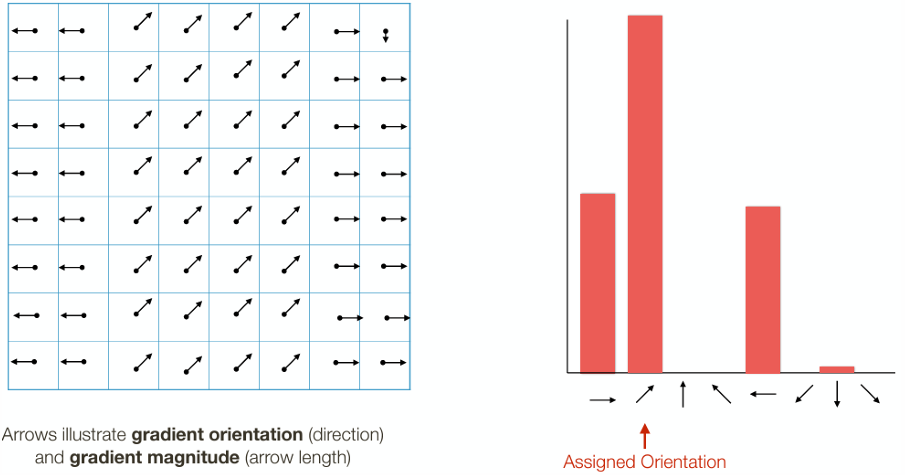

* Tercer paso - Generación de descriptores: Alrededor de cada *keypoint*, se toma una ventana de píxeles ($16$ x $16$) y se divide en celdas más pequeñas ($4$ x $4$). Después, para cada celda, se calcula un histograma de gradientes (8 direcciones diferentes). Esto genera un **vector de características** único para cada *keypoint*. Se le hace una normalización y *clipped* final.

> 📝 Toda la información anterior la podemos encontrar en las diapositivas del tema 3 de la asignatura.





Comenzamos entonces con la implementación del método. Para ello, nos ayudaremos del tutorial proporcionado por el profesor. Primeramente se ha de inicializar el detector SIFT, `SIFT_create()`. Seguidamente, podemos obtener los puntos detectados, junto a sus correspondientes descriptores, usando el método `detectAndCompute()`:

In [ ]:
def siftPoints(im,nfeatures=5000):
  sift = cv2.SIFT_create(nfeatures=nfeatures)
  kp, ds = sift.detectAndCompute(im, None)

  return kp,ds  # Keypoints, descriptors

> In OpenCV the output of a matching process is a vector of records. Each record provides information about the indexes of the matched KeyPoints and the distance between them.

$$$$

Nuestro siguiente paso ahora es el de hacer **matching**. Ya que sabemos cómo funciona el algoritmo de *SIFT*, tal y como se nos pide, vamos a proceder a emparejar los *keypoints* encontrados en dos imágenes distintas, que obviamente comparten puntos en común.

Como hemos venido haciendo en las prácticas de la asignatura, usaremos la librería `OpenCV`. Siempre que hagamos un match entre dos imágenes, el resultado será una lista de objetos `DMatch`. Este objeto tiene:

* `DMatch.distance` - La distancia entre descriptores encontrados, cuanto menor, mejor.
*` DMatch.trainIdx` - Indices de los descriptores en la imagen de partida.
* `DMatch.queryIdx` - Indices de los descriptores en la imagen a detectar en la de partida.
* `DMatch.imgIdx` - Indices de la imagen de partida.


Así, si queremos comparar y hacer matching entre dos imágnenes usaremos un método de match. Para hacer todo esto, existen diversos **criterios**, de los cuales nos vamos a centrar en 3 de ellos.

* **Brute Force**, `cv2.BFMatcher()`: Compara los descriptores de los keypoints de las dos imágenes para encontrar las correspondencias más cercanas. Para cada descriptor de la primera imagen, busca el descriptor más similar en la segunda imagen utilizando una métrica de distancia, como la euclidiana o la de hamming (descriptores binarios). Usaremos la euclidiana en nuestro caso, por defecto.
  * `crossCheck = True`, indica que el emparejamiento debe ser simétrico: si `descriptorA` de la primera imagen coincide con `descriptorB` de la segunda, entonces `descriptorB` también debe coincidir con `descriptorA`. Esto mejora la precisión, aunque puede reducir el número de emparejamientos válidos.

> 📝 `BFMatcher (int normType=NORM_L2, bool crossCheck=false)`, por defecto.

* **Lowe's ratio test**, `knnMatch()`: es una extensión del Brute-Force Matcher. En lugar de buscar solo el mejor emparejamiento para cada descriptor, encuentra los k vecinos más cercanos (más similares) en el conjunto de descriptores de la segunda imagen. Esto permite comparar los resultados y tomar decisiones más informadas, como aplicar el *ratio test de Lowe*.
  * *Lowe's ratio test*: es una técnica que utiliza los resultados de KNN Match para filtrar emparejamientos incorrectos o poco acertados. El test compara la distancia del mejor emparejamiento con la del segundo mejor emparejamiento. Si la proporción entre estas distancias es menor que un umbral (usaremos el dado por defecto, 0.75), se considera un emparejamiento válido.


Usaremos el primero de los criterios, variando el parámetro discutido y *Lowe's ratio test*, comparando el resultado entre todos ellos. Por último, usaremos la función` drawMatches()` para mostrar los 100 mejores emparejamientos de cada enfoque.

In [ ]:
flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS | cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG
flag = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS

def showKP(im,kp,title):
  img=cv2.drawKeypoints(im, kp, None, flags = flag)
  displayIm(img,title,1)

def showMatches(im1,kp1,im2,kp2,matches, N, title='Matches'):
  imBF=cv2.drawMatches(im1, kp1, im2, kp2, matches[:N], None, flags = flag)
  displayIm(imBF,title,2)

def matching(ds1,ds2,FlagMode='BF+CC'):
  if FlagMode=='BF':
    bf = cv2.BFMatcher()
    matches = bf.match(ds1, ds2)
    matches = sorted(matches, key=lambda x: x.distance)
    return matches
  elif FlagMode=='BF+CC':
    bf = cv2.BFMatcher(crossCheck = True)
    matches = bf.match(ds1, ds2)
    matches = sorted(matches, key=lambda x: x.distance)
    return matches
  elif FlagMode=='KNN':
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck = False)
    knnMatches = bf.knnMatch(ds1, ds2, k=2)
    good = []
    for m, n in knnMatches:
        if (m.distance / n.distance) < 0.75:
            good.append(m)

    good = sorted(good, key=lambda x: x.distance)
    return good
  else:
    return print('Error in Matching mode')

Como mencionamos, visualizaremos solo 100 de los mejores matches encontrados.

In [ ]:
numberOfmatches = 100

Una vez hemos implementado todo, solo queda cargar las imágenes y seguir los pasos:

1. Detectar los keypoints y descriptores de ambas imágenes, im1 e im2, usando SIFT, `siftPoints()`.
2. Visualizamos dichos puntos, `showKP()`.
3. Realizamos matching con cada uno de los criterios `['BF', 'BF+CC', 'KNN']`, usando `matching()`.
4. Visualizamos el resultado haciendo uso de `showMatches()`.

In [ ]:
img1=cv2.resize(readIm(get_image('IMG_20220312_102940_S.jpg'),1), (0,0), fx=0.5, fy=0.5)
im1=cv2.cvtColor(img1,cv2.COLOR_RGB2GRAY)
img2=cv2.resize(readIm(get_image('IMG_20220312_102944_S.jpg'),1), (0,0), fx=0.5, fy=0.5)
im2=cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)

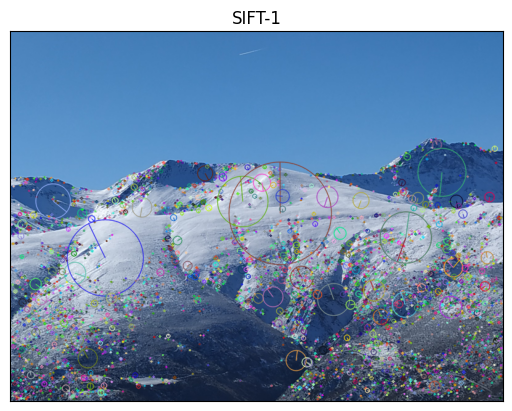

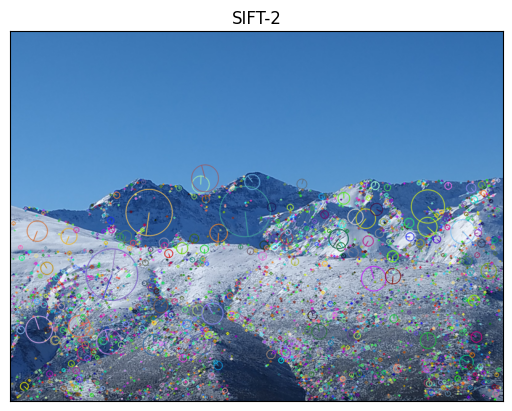

In [ ]:
kp1, ds1 = siftPoints(im1)
kp2, ds2 = siftPoints(im2)

showKP(img1, kp1, 'SIFT-1')
showKP(img2, kp2, 'SIFT-2')

> ℹ️ El tamaño de los círculos está relacionado con la escala del punto de interés (es decir, qué tan "importante" o grande es la región que representa en la pirámide de escala construida en SIFT). Además, la distribución de los *keypoints* es **densa** en áreas con textura y bordes (por ejemplo, en la nieve y la montaña).

#####**BF**

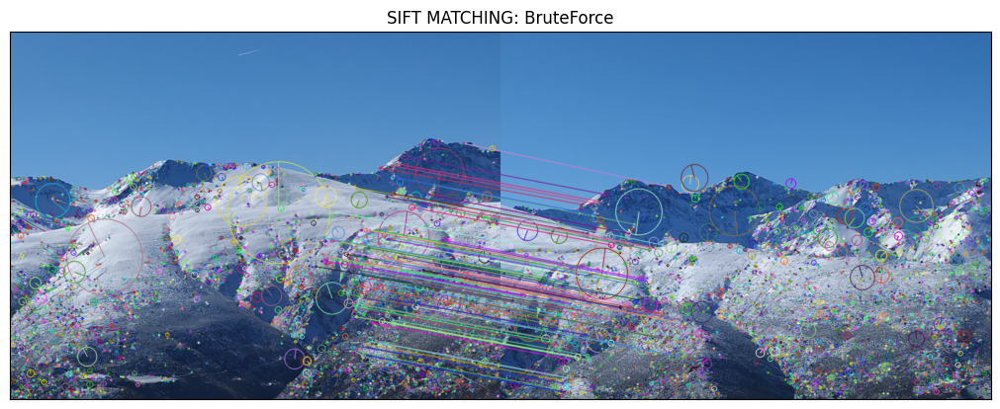

In [ ]:
matchesBF = matching(ds1, ds2, FlagMode='BF')
showMatches(img1, kp1, img2, kp2, matchesBF, numberOfmatches, title='SIFT MATCHING: BruteForce')

La imagen muestra el resultado de un matching, aparentenmente. La mayoría de estos emparejamientos parecen razonables y alineados correctamente, lo que sugiere que SIFT y el matcher de OpenCV están funcionando bien. A pesar de posibles diferencias de brillo o perspectiva, SIFT parece haber encontrado suficientes emparejamientos válidos, especialmente en zonas con alto cambio de gradiente (es decir, contornos de montañas).

Un mal emparejamiento mostaría línas que se cruzan y emparejamientos que podríamos notar visualmente que son incorrectos. Esto deja claro lo que ya sabíamos de teoría: **el cambio de perspectiva no ha afectado (si lo ha hecho ha sido insignificantemente) a SIFT**.

#####**BF+CC**

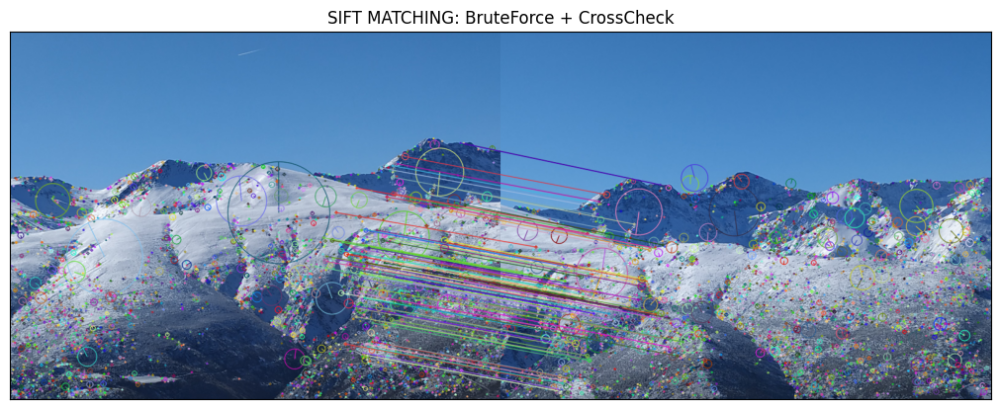

In [ ]:
matchesBF = matching(ds1, ds2, FlagMode='BF+CC')
showMatches(img1, kp1, img2, kp2, matchesBF, numberOfmatches, title='SIFT MATCHING: BruteForce + CrossCheck')

El resultado es bastante similar al anterior, y, por tanto, de buena calidad. Sin embargo, si que es notorio que el número de líneas detectadas (matching encontrados) es menor. Como ya explicamos, **CrossCheck** descarta emparejamientos ambiguos; un punto en la primera imagen debe coincidir con el mismo punto en la segunda imagen y viceversa.

Esto asegura un comportamiento en el algoritmo incluso mejor, pues se conservan solo los emparejamientos de **mayor calidad**.

#####**KNN + Lowe's ratio test**

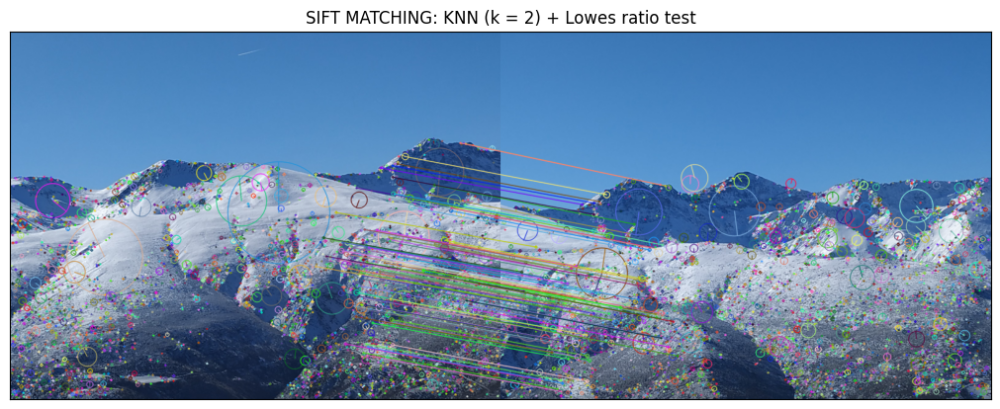

In [ ]:
matchesBF = matching(ds1, ds2, FlagMode='KNN')
showMatches(img1, kp1, img2, kp2, matchesBF, numberOfmatches, title='SIFT MATCHING: KNN (k = 2) + Lowes ratio test')

El resultado es bastante similar a los dos enfoques anteriores. De nuevo, las líneas parecen converger mayormente hacia un patrón lógico, como la alineación de montañas o estructuras, es un buen signo. Además, esta última técnica de matching asegura que solo se consideren coincidencias con una clara diferencia entre el mejor y el segundo mejor match. Esto nos asegura encontrar muchos menos falsos positivos y, de esta manera, tener un menor número de emparejamientos entre puntos, en contraste con BF.

**Tamaño del vector de características**

Como vamos a comparar con dos métodos más, es importante comprender y visualizar cómo es el vector de características encontrado, también dando esto información de cómo funciona cada uno. Así, podremos saber cuál parece más adecuado para nuestro problema, uniendo los resultados con esta información.

Para ello, podemos tomar los dos vectores calculados para las imágenes e imprimir su tamaño:

In [ ]:
print(ds1.shape)
print(ds2.shape)

(3838, 128)
(3863, 128)


Como se veía en teoría, el vector siempre será uno de **128 dimensiones**. Tenemos 16 celdas y 8 orientaciones para cada una.

## <font color='blue'>LBP (Local Binary Patterns)

<font color='blue'>Ahora, vamos a hacer lo mismo de antes, pero empleando las características LBP (del paquete `mahotas`: `mahotas.features.lbp`). Para ello debemos crear una pequeña ventana ($7\times7$ pixels) centrada en torno a los SIFT keypoints detectados, y calcular el vector de características correspondiente (empleando `radius=1` y `points=8`).

<font color='blue'>¿Posee este vector de características el tamaño indicado en teoría? Si no es así, ¿a qué se puede deber?


In [ ]:
!pip install mahotas
import mahotas

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 52.9 MB/s eta 0:00:00


Antes de proceder a la implementación del algoritmo de extracción de características, expliquemos un poco su funcionamiento.

$$$$

**Local Binary Patterns**

Visto en clase en contraposición al caráctero global de Harallick Features, LBP se encarga de computar una representación local de la textura de una imagen.

Es una técnica bastante simple y computacionalmente poco costosa, por lo que la convierte en una buena opción en escenarios donde el tiempo es importante.

**¿Cómo funciona?**

Se describen a continuación los pasos que sigue para obtener las características o *features*, dados *keypoints* de una imagen.

1. Se escoge un vecindario, es decir, una matriz (nuestro caso $7$ x $7$) y creamos un patrón local binario, esto es:
 * Para todos los valores alrededor del central, si es un valor menor a él, lo ponemos a 1.
 * Si se trata de un valor mayor que el del centro, lo dejamos a 0.

2. Se calcula el valor LBP para el centro de la matriz, siguiendo el esquema de la siguiente imagen.

<center><img src = https://www.researchgate.net/publication/341341744/figure/download/fig1/AS:890572973813761@1589340551159/Visualization-of-calculation-of-Local-Binary-Pattern-LBP-An-example-region-of-the.ppm height = '300'></center>

Este proceso se repite para cada punto de interés que tengamos. Como resultado, tenemos un histograma que muestra como de frecuente es cada una de las características obtenidas.

> 📝 Podemos ver un ejemplo. Calculamos para la imagen completa anterior, el histograma correspondiente y ver qué *feature vector* extraería LBP para ella.

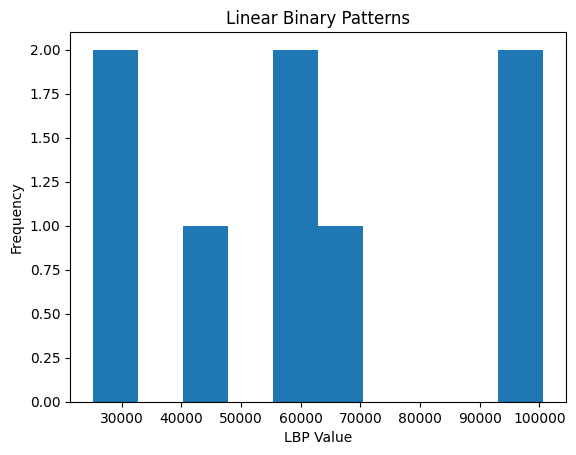

In [ ]:
lbp = mahotas.features.lbp(im1, 5, 5)
plt.hist(lbp)
plt.title('Linear Binary Patterns')
plt.xlabel('LBP Value')
plt.ylabel('Frequency')
plt.show()

La diferencia con nuestra implementación reside en el hecho de que realmente en lugar de usar la imagen entera, extraeremos características de una ventana de $7$ x $7$. Además, tomando los parámetros que se nos pide, realmente estaremos extrayendo en un radio de 1, 8 puntos, y por tanto estaremos trabajando en una matriz de $3$ x $3$ alrededor del keypoint.

* `radius = 1`, pues nos vamos a fijar en los píxeles inmediatamente adyacentes al punto de interés.

* `points = 8`, pues en una matriz de $3$ x $3$ el número de valores que rodean al centro son 8.

In [ ]:
def lbpFeatures(im, kp, radius = 1, points = 8):
  lbpfeatures = []
  points_used = []

  for k in kp:
    x, y = int(k.pt[0]), int(k.pt[1])
    if x - 3 >= 0 and x + 3 < im.shape[1] and y - 3 >= 0 and y + 3 < im.shape[0]:

      patch = im[y- 3: y + 4, x - 3: x + 4]
      lbp = mahotas.features.lbp(patch, radius, points)
      lbpfeatures.append(lbp)
      points_used.append(k)

  return np.array(np.float32(lbpfeatures)), points_used

> ⚠️ Importante tener en cuenta para la implementación que los keypoints tienen la forma $(x,y)$ en coordenadas, mientras que para la interpretación a nivel de matriz, la $y$ será la fila (eje Y) y la $x$ será la columna (eje X).

#####**BF**

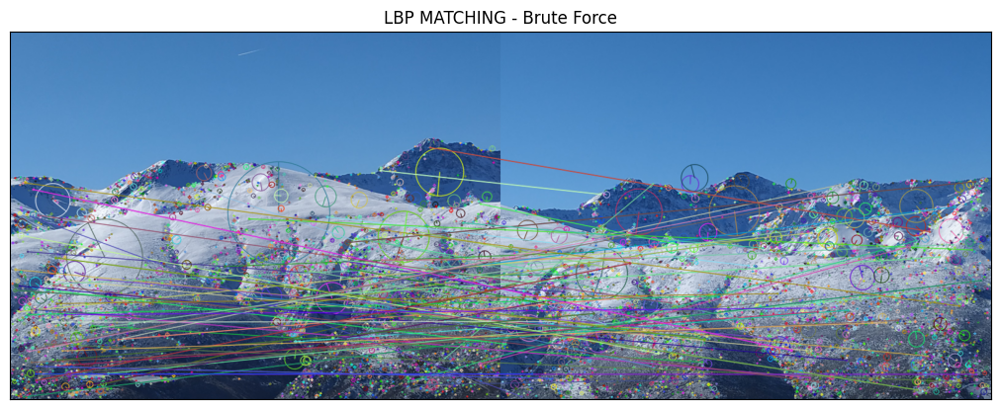

In [ ]:
lbp1, kp1_used = lbpFeatures(im1, kp1)
lbp2, kp2_used = lbpFeatures(im2, kp2)

matchesBF = matching(lbp1, lbp2, FlagMode='BF')
showMatches(img1, kp1_used, img2, kp2_used, matchesBF, numberOfmatches, title='LBP MATCHING - Brute Force')

#####**BF+CC**

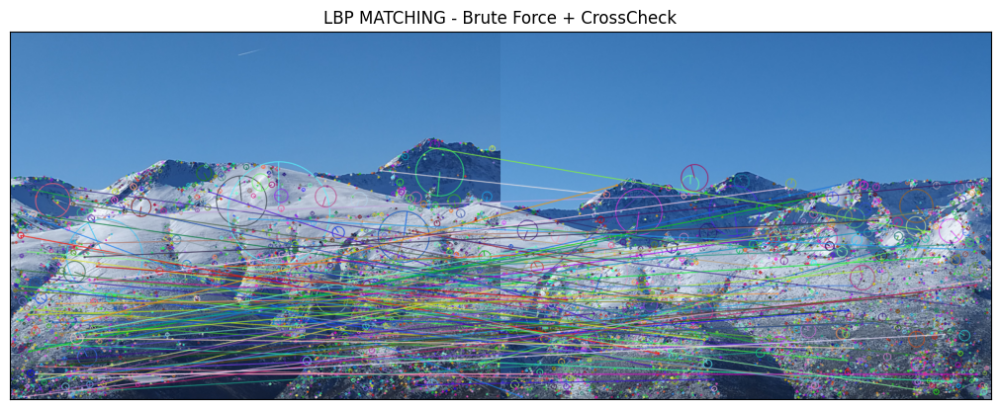

In [ ]:
matchesBF = matching(lbp1, lbp2, FlagMode='BF+CC')
showMatches(img1, kp1_used, img2, kp2_used, matchesBF, numberOfmatches, title='LBP MATCHING - Brute Force + CrossCheck')

#####**KNN + Lowe's ratio test**

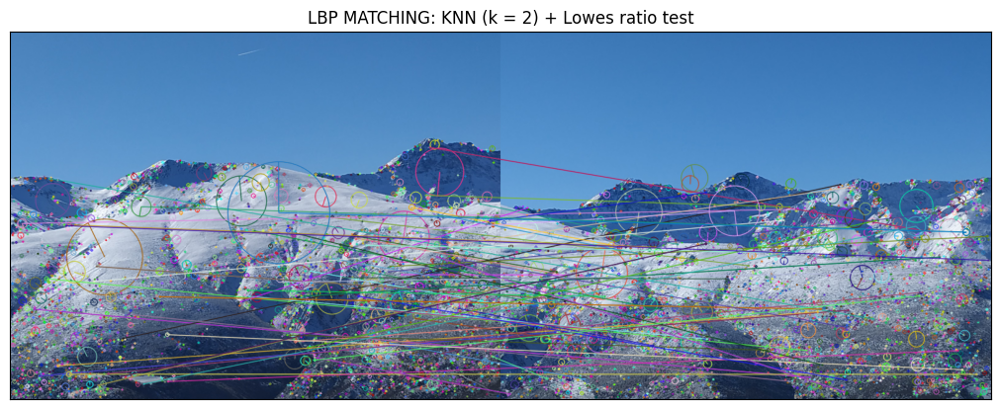

In [ ]:
matchesBF = matching(lbp1, lbp2, FlagMode='KNN')
showMatches(img1, kp1_used, img2, kp2_used, matchesBF, numberOfmatches, title='LBP MATCHING: KNN (k = 2) + Lowes ratio test')

**Tamaño del vector de características**



In [ ]:
print(lbp1.shape)
print(lbp2.shape)

(3834, 36)
(3859, 36)


En teoría, el tamaño del vector de características generado por LBP depende de la cantidad de patrones binarios que se pueden formar con los puntos vecinos. Para `points=8`, el tamaño del vector debería ser $2^8=256$ (si se consideran todos los patrones posibles). Sin embargo, si se utiliza una variante como "*uniform LBP* ", el tamaño del vector será menor porque se reducen los patrones redundantes.

## <font color='blue'>HOG (Histogram of oriented gradients)

<font color='blue'>Ahora hacemos lo mismo, pero con la implementación de HOG disponible en `skimage.feature`. Se deben emplear $9$ orientaciones, $8\times8$ pixels por celda, y $2\times2$ celdas por bloque (importante hacer _resize_ de la ventana/región de $7\times7$ al tamaño estándar de HOG: $64\times128$ pixels). ¿Cuál es la dimensionalidad de este vector de características y por qué?

Como hemos hecho para los dos anteriores métodos, previo a la implementación del algoritmo, se da una explicación del mismo para entender correctamente lo que se está haciendo.

$$$$


**HOG - Histogram of Oriented Gradients**

De nuevo, estamos tratando con un extractor de características, es decir, conseguir descriptores dados unos *keypoints* calculados previamente. **¿Cómo funciona?**

1. Se calculan los gradientes de la imagen para capturar cambios de intensidad.

2. Se divide la imagen en bloques de $16$ x $16$, que a su vez se dividen en celdas $8$ x $8$.

3. Se calcula la orientación del gradiente para cada celda y se extrae un histograma de de 10 componentes (de 0º a 180º de 20 en 20 grados). Además, se pondera por su magnitud. Esto genera un vector de características para la celda. *En nuestro caso usaremos en su lugar 9 orientaciones distintas*.

4. Se normalizan los histogramas de cada bloque para reducir el efecto de cambios en la iluminación.

5. Se concatenan todos los histogramas.

<center><img src = https://th.bing.com/th/id/OIP.FI2nfoRLJXAM7SrxiGWofgHaDh?rs=1&pid=ImgDetMain height = '200'></center>

Además de generar un vector de características, podemos visualizar una imagen de HOG, gracias al parámetro `visualize = True`. Como ejemplo, podemos escoger una de las imágenes anteriores y comprobar su funcionamiento mediante el uso del código de la página oficial de `skimage`, [https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.hog].

La visualización realizada consiste en, una vez calculados todas las orientaciones, para cada celda y bloque de orientación, la imagen contiene un segmento de línea que está centrado en el centro de la celda, es perpendicular al punto medio del rango de ángulos cubierto por el bloque, y tiene una intensidad proporcional al valor correspondiente del histograma. Veámos cómo queda:








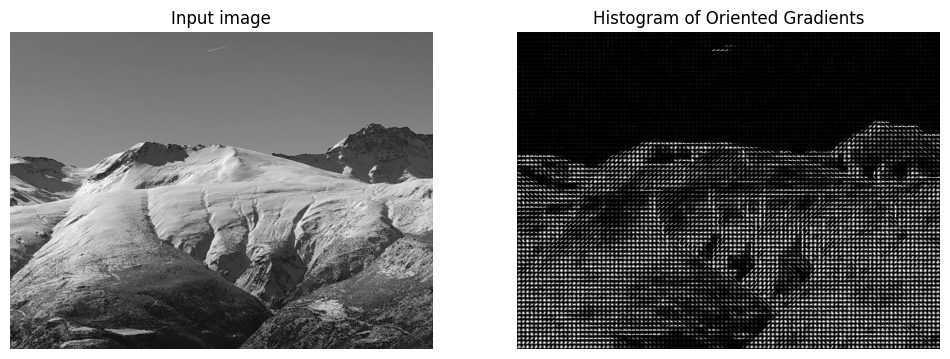

In [ ]:
from skimage import exposure
from skimage.feature import hog

fd, hog_image = hog(
    img1,
    orientations=9,
    pixels_per_cell=(8, 8),
    cells_per_block=(2, 2),
    visualize=True,
    channel_axis=-1,
)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 8), sharex=True, sharey=True)

ax1.axis('off')
ax1.imshow(im1, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')
plt.show()

Podemos visualizar así, para cada bloque de la imagen, las orientaciones principales de los gradientes. La visualización de HOG, además, resalta los bordes y contornos predominantes de la imagen, evaluando así si las características capturadas son representativas de la imagen en sí.

$$$$

Podemos pasar ahora a su implementación. El enfoque será el mismo que para LBP, usando la ventana de 7x7. Discutimos sus parámetros.

* `cv2.resize(patch, (64, 128))`: Tal y como se nos indica en el enunciado, cambiaremos el tamaño de la ventana para cada llamada a HOG, pues es el usado en el paper original.

* `orientations`: Orientaciones a calcular en cada bloque.

* `pixels_per_cell`: Píxeles en cada una de las celdas en que se divide un bloque.

* `cells_per_block`: Número de celdas para cada bloque.

* `feture_vector`: Devuelve el histograma en forma de vector de características.

In [ ]:
def hogFeatures(im, kp, orientations = 9, pixels_per_cell = (8, 8), cells_per_block=(2, 2)):
  hogfeatures = []
  points_used = []

  for k in kp:
    x, y = int(k.pt[0]), int(k.pt[1])
    if x - 3 >= 0 and x + 3 < im.shape[1] and y - 3 >= 0 and y + 3 < im.shape[0]:

      patch = im[y- 3: y + 4, x - 3: x + 4]
      patch = cv2.resize(patch, (64,128))
      hg = hog(patch, orientations = orientations, pixels_per_cell = pixels_per_cell,
                cells_per_block = cells_per_block, feature_vector = True)
      hogfeatures.append(hg)
      points_used.append(k)

  return np.array(np.float32(hogfeatures)), points_used

La implementación es muy similar a la anterior, teniendo ahora en cuenta el *resize* necesario. Podemos entonces pasar a la parte del **matching**, comparando los tres enfoques discutidos previamente.



#####**BF**

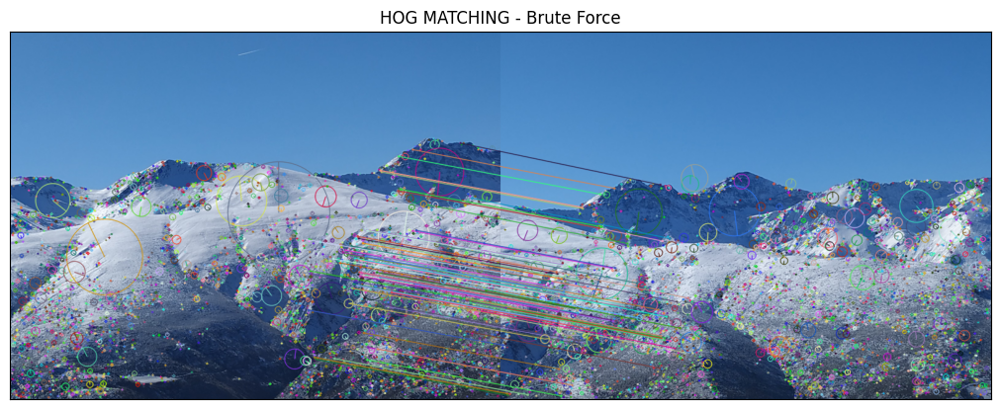

In [ ]:
hog1, kp1_used = hogFeatures(im1, kp1)
hog2, kp2_used = hogFeatures(im2, kp2)

matchesBF = matching(hog1, hog2, FlagMode='BF')
showMatches(img1, kp1_used, img2, kp2_used, matchesBF, numberOfmatches, title='HOG MATCHING - Brute Force')

#####**BF+CC**

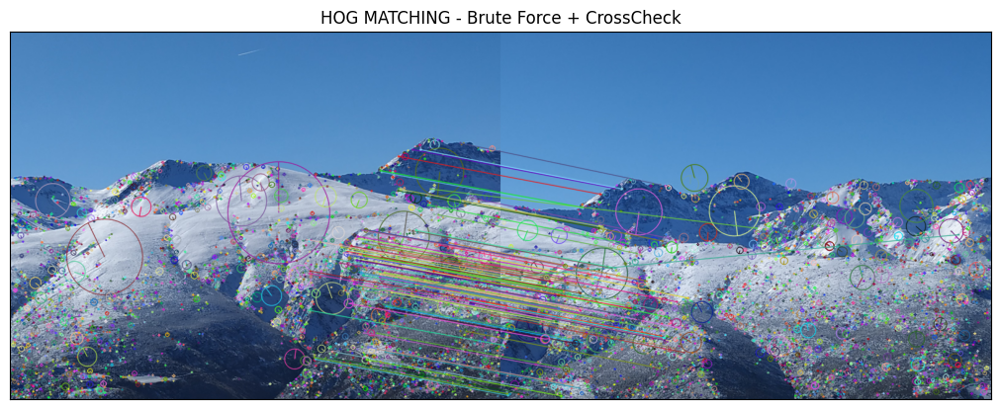

In [ ]:
matchesBF = matching(hog1, hog2, FlagMode='BF+CC')
showMatches(img1, kp1_used, img2, kp2_used, matchesBF, numberOfmatches, title='HOG MATCHING - Brute Force + CrossCheck')

#####**KNN + Lowe's ratio test**

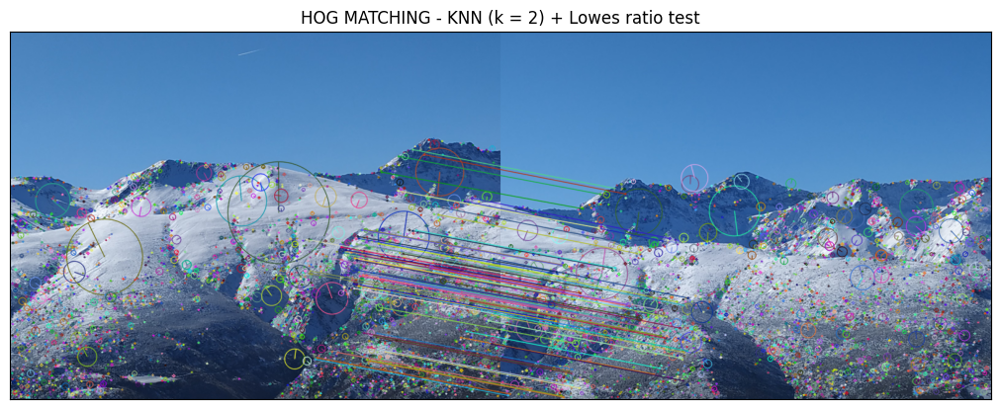

In [ ]:
matchesBF = matching(hog1, hog2, FlagMode='KNN')
showMatches(img1, kp1_used, img2, kp2_used, matchesBF, numberOfmatches, title='HOG MATCHING - KNN (k = 2) + Lowes ratio test')

Parece que volvemos a tener muy buenos resultados. Las líneas vuelven a tener sentido, pues para LBP lo habían perdido completamente. Ahora las correspondencias son paralelas (o al menos no se cruzan) y escogen matches muy parecidos a los que SIFT encontraba.

**¿Qué diferencias encontramos con SIFT?**

La primera y más evidente es el **tiempo**. La ejecución de esta última técnica ha llevado bastante más tiempo que para SIFT. Esto se debe a cómo opera cada uno internamente. Por ejemplo, los gradientes en HOG se calculan para cada celda, mientras que SIFT lo hace para una región. La resolución de la imagen también es importante, pues con HOG hemos visto que tiene que ser mayor y, evidentemente, esto conlleva muchas más operaciones. Se podría decir que HOG es más **exhaustivo** mientras que SIFT se centra en **regiones** más relevantes.

La segunda diferencia radica en el tamaño del vector de características, que se discute a continuación.

**Tamaño del vector de características**

In [ ]:
print(hog1.shape)
print(hog2.shape)

(3834, 3780)
(3859, 3780)


De nuevo, esta información la podemos constrastar con la de teoría, pues sabemos que si concatenamos los histogramas:

* Tomando bloques de $16$ x $16$ en la imagen de 64 x 128, tendremos 7 $\cdot$ 15 = 105 bloques distintos.

* 9 orientaciones por 4 celdas por bloque, vectores de 36 dimensiones.

* Finalmente, 105 bloques distintos por 36, dimensionalidad de **3780**.

<font color='blue'> ¿Cuál de los descriptores anteriores parece más adecuado para _keypoint matching_ y por qué?

A la vista de los resultados, podemos elegir claramente cuál parece más adecuado para nuestro problema de *matching*.

* **LBP** no ha demostrado ser nada efectivo ni preciso en el problema, pues ha detectado emparejamientos que incluso a simple vista podríamos corregir. Esta técnica tiene limitaciones en cuanto cambios de iluminación, ruido, y en su capacidad para capturar patrones globales, como podrían ser las montañas en nuestro caso. Existen extensiones del algoritmo que igual podrían mejorar su rendimiento en este caso. Sin embargo, si trabajamos dentro de la misma imagen, y buscamos encontrar patrones locales, LBP puede ser una buena elección.

* **HOG** ha demostrado tener una muy buena eficacia y precisión parecida a SIFT. Sin embargo, el problema principal ha sido el del tiempo de ejecución. El tamaño del vector de características, así como el número de operaciones que se han de realizar, hacen que sea mucho más lento que LBP y SIFT.

Es por esto, que **SIFT parece mucho más adecuado para la problemática**, además de servir también como detector de puntos de interés. Esto lo convierte en el mejor enfoque visto aquí y por el que nos decantaríamos en una situación real. Siempre que haya cambios de perspectiva, ruido o incluso muchos cambios de iluminación, SIFT ha demostrado ser de gran utilidad y muestra una gran robustez ante estas situaciones.

# <font color='blue'>**Ejercicio 3:** Creación de panoramas/mosaicos (_Image Stitching_) empleando homografías (5 puntos)

<font color='blue'>Ahora vamos a calcular homografías entre imágenes y usarlas para construir un mosaico/panorama. Para calcular la homografía entre dos imágenes, hay que llamar a la función `cv2.findHomography()`, que toma como entrada las listas de _keypoints_ y los matches/emparejamientos encontrados. Se debe usar RANSAC para realizar una estimación robusta.

Es **esencial** entender las homografías para comprender y poder implementar de manera correcta este ejercicio sobre *image stitching*. Para ello, respondamos a las siguientes preguntas:

$$$$

**¿Qué es una homografía?**

Para empezar a entenderlas, es necesario hablar de las **transformaciones afines**, que son combinaciones de transformaciones lineales y traslaciones. Esto es:

$$
\begin{bmatrix}
x' \\
y' \\
z
\end{bmatrix}
=
\begin{bmatrix}
a & b & c \\
d & e & f \\
0 & 0 & 1
\end{bmatrix}
\begin{bmatrix}
x \\
y \\
z
\end{bmatrix}
$$

Usamos una matriz 3x3 pues las traslaciones no se pueden expresar con matrices 2x2. Usamos lo que se conocen como **coordenadas homogéneas**, es decir, añadimos una última coordenada final ($z$) que permite hacer este tipo de transformaciones.


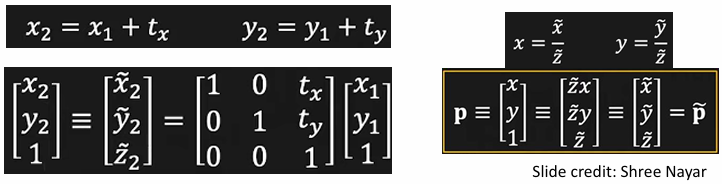

> Siempre que tengamos como última fila $( 0 \space 0 \space 1 )$ se tratará de una transformación afín.

$$$$

Justamente de no restringir esta última fila a esos valores, surgen las **homografías**. Esto nos permite ahora hacer transformaciones más complejas, como mapear un plano a otro, mediante un punto. Además, esto provoca que las líneas paralelas no queden paralelas al transformarlas.

> ⚙️ Esto, intuitivamente, podemos deducir que es de gran utilidad pues si tenemos una imagen cualquiera tomada desde un ángulo, una homografía puede corregir la perspectiva para que la imagen aparezca "vista de frente", por ejemplo.


**En pocas palabras, una homografía en visión por computador es una transformación que nos permite relacionar puntos de una imagen en otra, generalmente vistas sobre la misma superficie/panorama/área, pero desde distintas perspectivas.**

$$$$

Matemáticamente, una homografía es una matriz $ H $ de $ 3 \times 3 $ que cumple con la siguiente ecuación:

$$
\begin{bmatrix} x' \\ y' \\ z' \end{bmatrix} =
k \cdot \begin{bmatrix}
h_{11} & h_{12} & h_{13} \\
h_{21} & h_{22} & h_{23} \\
h_{31} & h_{32} & h_{33}
\end{bmatrix} \begin{bmatrix} x \\ y \\ z \end{bmatrix}
$$

* Siendo $k$ un factor de escala que nos da puntos equivalentes en las coordenadas.

$$$$

Tendremos entonces 8 grados de libertad en la matriz: **¿Por qué 8?**
Cada correspondencia que hallemos entre imágenes resuelve dos restricciones, y estamos buscando 4 correspondencias para que la calidad sea decente. Generalmente se usan muchas más correspondencias.

$$$$

**¿Para qué las usaremos en esta práctica?**

Nuestro objetivo en este ejercicio será el de crear una imagen panorámica combinando varias imágenes tomadas desde diferentes ángulos, compartiendo siempre el mismo punto desde el que se tomó la fotografía. Aquí las homografías se usan para transformar las imágenes individuales al **mismo marco o lienzo de referencia**. Es el llamado ***image stitching***:

\

<center><img src = https://i.pinimg.com/originals/ee/21/a3/ee21a3fe2e3ca0e7057eac4b4c37b960.jpg height = '250'></center>

$$$$

Pasamos directamente a la implementación de las homografías:

* De nuevo, como venimos haciendo en toda la práctica, haremos uso de la librería de OpenCV. Llamaremos a la función `findHomography()`:

  * `srcPts`: Puntos de interés o keypoints de la imagen de partida
  * `dstPts`: Puntos de interés o keypoints de la imagen de llegada
  * `method`: Método usado para construir la homografía (ahora lo explicaremos).
  * `ransacReprojThreshold` o `Ransac_Error`: Error máximo permitido para tratar un par de puntos como un inlier.

El parámetro `matches` que usamos en `homography()` será una simple llamada a los ya usados SIFT y `matching()`, en el ejercicio anterior, que nos detecte los emparejamientos entre las dos imágnes sobre las que constuiremos la homografía. Por último, el parámetro `MIN_MATCH_COUNT`, establece el número mínimo de matches encontrados para calcular la homografía.

In [ ]:
def homography(kp1,kp2,matches, Ransac_Error,MIN_MATCH_COUNT=20):
  H = None
  if len(matches) > MIN_MATCH_COUNT:
    srcPts = np.float32([kp1[m.queryIdx].pt for m in matches])   #  Imagen de partida
    dstPts = np.float32([kp2[m.trainIdx].pt for m in matches])   #  Imagen de llegada

    #  El método devuelve también las máscaras correspondientes a los inliers y outliers
    #   pero en este caso no son relevantes, solo buscamos H
    H, _ = cv2.findHomography(srcPts, dstPts, cv2.RANSAC, Ransac_Error)
  else:
    print('Error - very few matches')
  return H

Vemos que los pasos, tal y como se nos indica en el guión de las prácticas son:

1. Detectamos y hacemos matching de los keypoints
2. Internamente, se convierten los puntos a coordenadas homogéneas
3. Estimamos la homografía haciendo uso de **DLT** (resolución de homografías implementado en `findHomography()`) y **RANSAC**.

**¿Qué es RANSAC y qué papel tiene?**

Se utiliza en este caso para estimar homografías, a partir de datos que contienen outliers (datos incorrectos o ruidosos). En el caso de la obtención de homografías, RANSAC es crucial para identificar y **filtrar** correspondencias de puntos incorrectas entre dos imágenes. Es por eso que se establece un error máximo permitido, como parámetro para RANSAC.

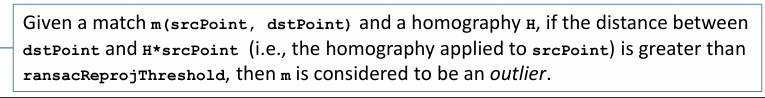

Esto lo hace cogiendo particiones entre *inliers* y *outliers* y calculando modelos de regresión lineal, quedándonos al final con el mejor de todos los calculados.

Todo esto lo convierte en un algoritmo **robusto ante outliers** y que funciona bastante bien para modelos sencillos. Sin embargo, es sensible al número de parámetros y el tiempo computacional puede dispararse.

<font color='blue'>Para componer el mosaico necesitamos realizar los siguientes pasos:

> <font color='blue'>a) Escoger un tamaño máximo para el lienzo/canvas sobre el que vamos a pegar y "encajar" todas las imágenes (tamaño que depende del número de imágenes a unir/componer y sus dimensiones).

> <font color='blue'>b) Escoger la imagen central que dará los ejes al mosaico (que debemos escoger con criterio, de cara a mejorar la calidad final del mosaico).

> <font color='blue'>c) Establecer el orden de cada imagen respecto a la central (es decir, podemos asumir que, a priori, conocemos la posición de cada imagen en la serie de imágenes tomadas y, como consecuencia, conocemos qué imágenes están a la derecha y/o a la izquierda de otras; en otras palabras, conocemos el orden en que fueron tomadas las fotografías en el movimiento de izquierda a derecha sacando la panorámica).

> <font color='blue'>d) Calculamos la homografía para copiar la imagen central en el lienzo (que es solamente una traslación).

> <font color='blue'>e) A continuación debemos ir leyendo las imágenes de izquierda a derecha, y debemos calcular la homografía entre cada par de imágenes consecutivas.

> <font color='blue'>f) Con la información anterior, debemos componer la homografía entre cada imagen y el lienzo/canvas. Es decir, la matriz que lleva cada imagen/foto a su posición correcta en el lienzo.

> <font color='blue'>g) Ahora, debemos utilizar las homografías calculadas para transportar las imágenes al lienzo (por medio de la función `cv2.warpPerspective()`). Es importante ir de fuera hacia dentro, es decir, desde los extremos hasta el centro, pegando en último término la imagen central, que es la que presentará un menor grado de deformación.

> <font color='blue'>i) Finalmente, debemos eliminar las regiones negras de los bordes del canvas para mejorar la calidad final del mosaico.

<font color='blue'>Se debe componer el mosaico de Sierra Nevada con las imágenes `IMG_20220312_102934_S.jpg`, `IMG_20220312_102937_S.jpg`, `IMG_20220312_102940_S.jpg`, `IMG_20220312_102942_S.jpg`, `IMG_20220312_102944_S.jpg`, `IMG_20220312_102946_S.jpg`, `IMG_20220312_102948_S.jpg`, `IMG_20220312_102950_S.jpg`, `IMG_20220312_102951_S.jpg`, `IMG_20220312_102954_S.jpg`, y `IMG_20220312_102957_S.jpg`. Se recomienda operar con ellas con la mitad de resolución. Es decir, se debe hacer un resize para emplear imágenes de la mitad de filas y columnas del tamaño original.


En lo siguiente, combinaremos continuamente el ámbito teórico del ejercicio con el ámbito práctico. Esto lo haremos pues vamos a ir comentando y explicando cada una de las funciones que se irán creando, tratando de enteder el por qué de cada una y el papel que desempeñan.

$$$$

* `computeLocalHomographies()`: Se trata de una función que dada una lista de imágenes, escogerá las imágenes de dos en dos y calculará una homografía que vaya de la primera a la segunda. De esta manera, si partimos de la lista que se nos indica más arriba, obtendremos una lista del la misma longitud - 1, conteniendo las homografías que nos llevan de unas a otras, ambas consecutivas.

* `mosaicHomographies()`: Partiendo de la lista de homografías dadas por la función anterior, calcula, para cada una de las imágenes del canvas, la homografía que va directamente desde ellas hasta la que se encuentra en el índice `idx`, que en nuestro caso cuando llamemos a la función será la central.

$$$$

**¿Qué sentido tiene implementar esta función?**

Aquí entran en juego las **composiciones de homografías** que discutíamos en clases prácticas. Para cada imagen, hemos de calcular una transformación que nos lleve de la imagen al canvas. Para ello, se ha de calcular la transformación a cada una de las imágenes intermedias.

No obstante, calcular todas las intermedias es equivalente a hacer la composición de todas ellas. ¿Cómo? Lo veíamos en clase:

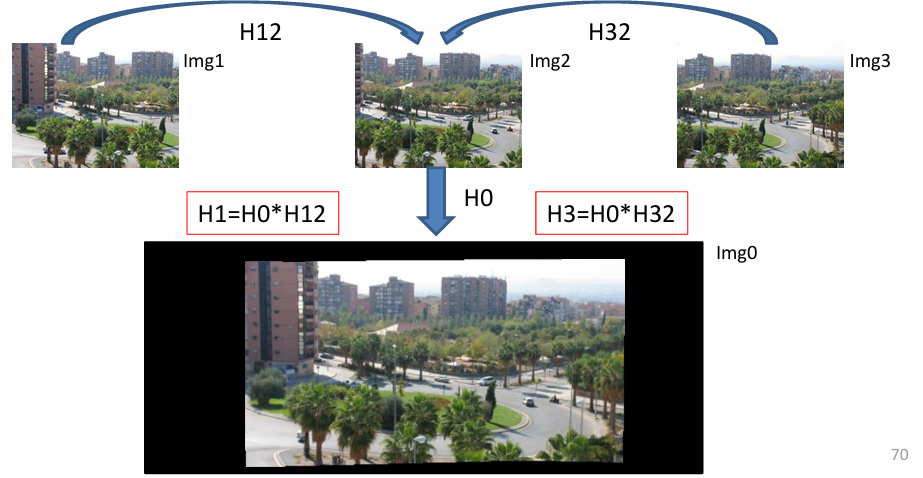

La multiplicación de las matrices correspondientes a las homografías nos da la transformación final que debemos hacer a cada una de las imágenes que no son las centrales (a la imagen central solo debemos aplicar una traslación elemental hasta el canvas).

El proceso a seguir es simple:

1. Para las imágenes a la izquierda de la imagen elegida como central, solo deberemos ir multiplicando las correspondientes homografías y obtendremos cada una de las homografías para ellas.

2. Para las imágenes a la derecha de la central, deberemos ir multiplicando pero en este caso por las **inversas** de cada una de las homografías, hasta llegar a la central.

$$$$

* `axesHomography()`: Por último se nos da esta función implementada para trasladar la imagen central hasta el canvas.

In [ ]:
def computeLocalHomographies(images, method='KNN', Ransac_Error=5.0):
  H = []

  for i in range(len(images)-1):
    kp1, ds1 = siftPoints(images[i])
    kp2, ds2 = siftPoints(images[i+1])

    matches = matching(ds1, ds2, FlagMode = method)

    h = homography( kp1, kp2, matches, Ransac_Error)

    H.append(h)

  # Devuelve una lista de homografías para las imágenes consecutivas en 'images'
  return H

def mosaicHomographies(H,idx):

  for i in range(idx-2, -1, -1):
    H[i] = H[i+1] @ H[i]

  for i in range(idx+1, len(H)):
    if i == idx+1:
      H[i] = np.linalg.inv(H[i-1]) @ np.linalg.inv(H[i])
    else:
      H[i] = H[i-1] @ np.linalg.inv(H[i])

  H[idx] = np.linalg.inv(H[idx])

  return H

# this function fixes the homography from the central image to the canvas
def axesHomography(sizeim,sizecanvas):
  H=np.eye(3)
  H[0,2]=sizecanvas[1]//2-sizeim[1]//2
  H[1,2]=sizecanvas[0]//2-sizeim[0]//2
  return H

Ahora la siguiente función que hemos de crear es `setCanvas()`. Esta función creará el canvas de cero. Se nos dan las filas y las columnas como parámetros y además:

* `flagColor`: especifica si el canvas debe ser a color, 3 canales, o en escala de grises, 1 canal.
* `nim`: Escala por la que se multiplicará el número de filas y de columnas. Vendrá dado por el número de imágenes que usemos.

Las dimensiones del canvas vendrán dadas por las **dimensiones máximas** de todas las imágenes a transformar, de manera que ninguna de ellas se quede fuera.

$$$$

También se nos proporciona ya implementada la función `blackOut()`, a la que llamaremos una vez hayamos terminado de trasladar todas las imágenes al canvas. Esta mejorará el resultado del *image stitching*, dándonos un resultado algo más depurado eliminando filas y columnas redundantes.

In [ ]:
def setCanvas(row,col,flagColor,nim=2):
  channels = 3 if flagColor else 1

  canvas = np.zeros((row*nim, col*nim, channels), dtype=np.uint8)

  return canvas

# This function removes the redundant pixels from the canvas
def blackOut(img, offset=0):
  if len(img.shape)==3:
    im =cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    mask = np.array((im > 0), np.uint8)
    x,y,w,h=cv2.boundingRect(mask)
    return img[y+offset:y+h-offset,x+offset:x+w-offset,:]
  else:
    mask = np.array((img > 0), np.uint8)
    x,y,w,h=cv2.boundingRect(mask)
    return img[y+offset:y+h-offset,x+offset:x+w-offset]


Por último, se implementa el paso final, componer todo el mosaico íntegramente. Para ello se llama a la función `composeMosaic()`:

* `images`: Será la lista de imágenes a llevar al canvas.
* `canvas`: El canvas creado mediante `setCanvas()`.
* `H`: Lista de homografías calculadas mediante `computeLocalHomographies()` y `mosaicHomographies()`.
* `idx`: El índice de la imagen central
* `H0`: La homografía que da la traslación de la imagen central hasta el canvas.

Esta función aglutina todo lo implementado anterior y mostrará el canvas obtenido mediante el uso de todas las funciones anteriores. Para ello, haremos uso de la función `cv2.warpPerspective()`.

TODO: HABLAR DE LA INTERPOLACION Y EL FLAG DE BORDER TRANSPARENT, ASI COMO DE LA FUNCION WARPPERSPECTIVE

In [ ]:
# This function composes the mosaic. It receives:
# * images: the list of images
# * canvas: the canvas, generated through the application of setCanvas()
# * H: the list of homographies, obtained through the application of
# computeLocalHomographies() and mosaicHomographies()
# * idx: the index of the central image
# * H0: the homography that represents the translation from the central image to the
# canvas obtained through the application of axesHomography()
def composeMosaic(images,canvas,H,idx,H0):

  canvas_comp = []

  canvas_height, canvas_width = canvas.shape[0:2]

  h_idx = len(H) - 1

  for i, img in enumerate(images[:idx]):
    H_to_canvas = H0 @ H[i]
    canvas = cv2.warpPerspective(img, H_to_canvas, (canvas_width, canvas_height), dst = canvas,
                                 flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    canvas_comp.append(canvas.copy())

  for i, img in enumerate(images[-1:idx:-1]):
    H_to_canvas = H0 @ H[h_idx]
    canvas = cv2.warpPerspective(img, H_to_canvas, (canvas_width, canvas_height), dst = canvas,
                                      flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    canvas_comp.append(canvas.copy())
    h_idx -= 1

  canvas = cv2.warpPerspective(images[idx], H0, (canvas_width, canvas_height), dst = canvas,
                                         flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)

  return canvas_comp, canvas

<font color='blue'>Se debe mostrar la composición, paso a paso, del canvas, es decir, el canvas a medida que se le van incorporando cada una de las imágenes, así como la composición final del mosaico. Finalmente, se debe comparar el resultado de nuestra composición manual con el _stitcher_ de OpenCV: `cv2.Stitcher`.

<font color='blue'>Al igual que en todas las demás entregas y ejercicios, resulta fundamental documentar el trabajo realizado, y explicar pausadamente todas las etapas implementadas (qué se ha hecho, cómo se ha hecho, y por qué se ha hecho así).

#####**Resultado final**

Dos notas importantes sobre el resultado final que hemos de tener en cuenta:

> 📝El **orden** en que vamos rellenando el canvas es muy importante. Conforme componemos distintas homografías, la imagen de partida se irá deformando más y más. Esto nos lleva a considerar el siguiente orden:
* las imágenes más alejadas de la imagen central ( + composiciones de homografías $\implies$ + deformadas ) las añadiremos antes al canvas.
* las más cercanas a la central las añadiremos en último lugar, hasta añadir por último la central

> 📝Es también crucial la elección de la que será nuestra **imagen central**. La imagen central no debe ser necesariamente la correspondiente al índice central en nuestra lista de imágenes. Puede ocurrir que tengamos muchas más imagenes superpuestas de un lado que de otro y por tanto la imagen esté distorsionada. Debemos intentar que la imagen central se corresponda con el "centro real".



In [ ]:
PREFIX='IMG_20220312_1029'
nameImages=['34_S.jpg','37_S.jpg','40_S.jpg','42_S.jpg','44_S.jpg','46_S.jpg','48_S.jpg','50_S.jpg','51_S.jpg','54_S.jpg','57_S.jpg']
images = []

for item in nameImages:
   images.append(cv2.resize(readIm(get_image(PREFIX+item),flagColor=1), (0,0), fx=0.5, fy=0.5))

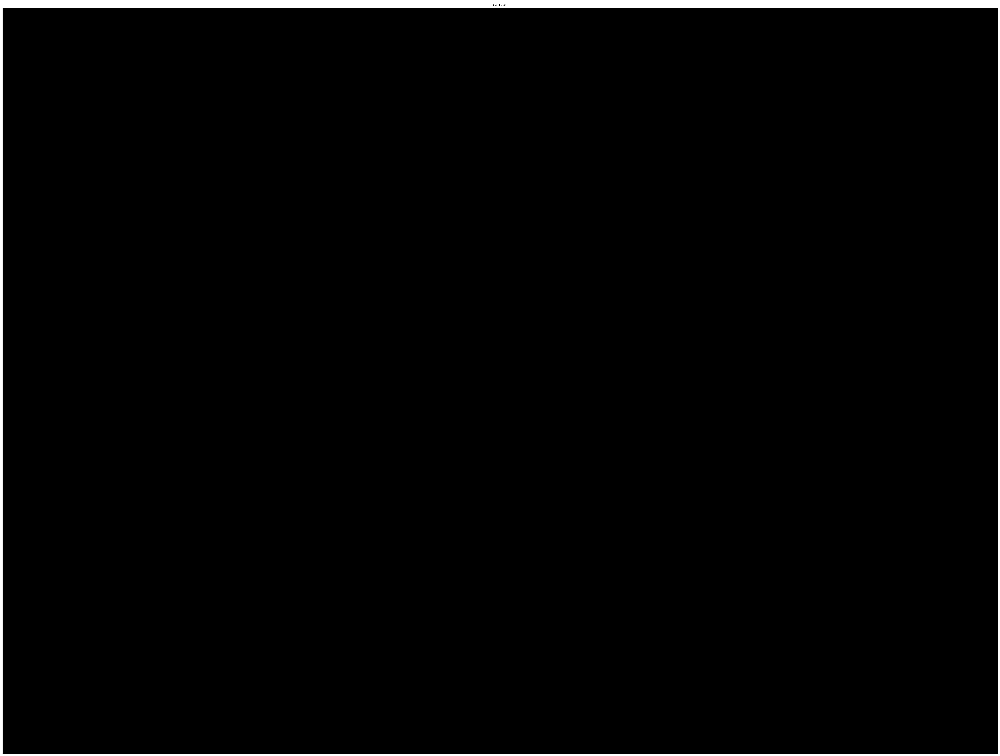

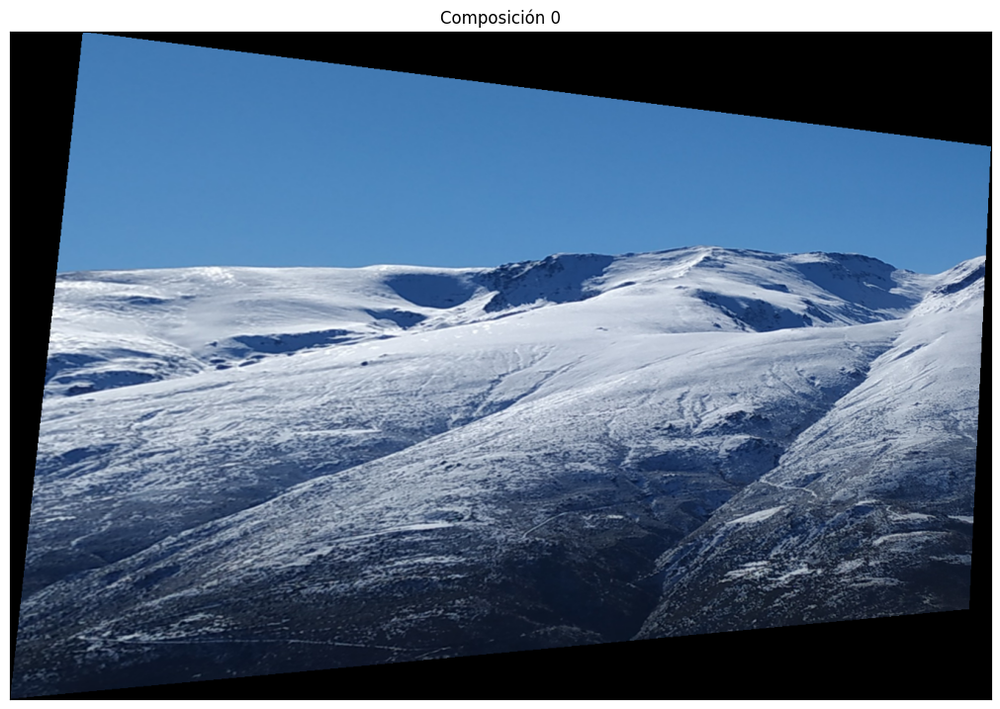

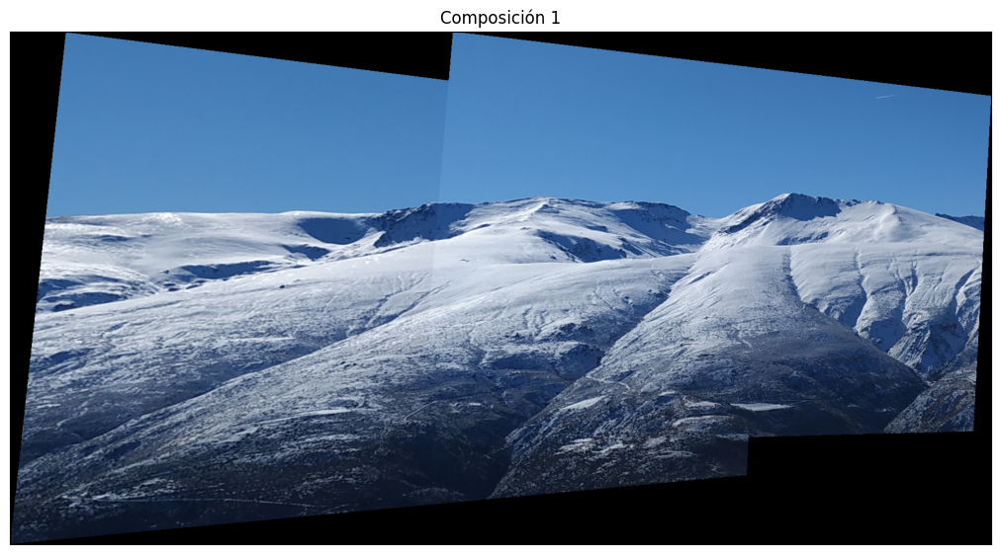

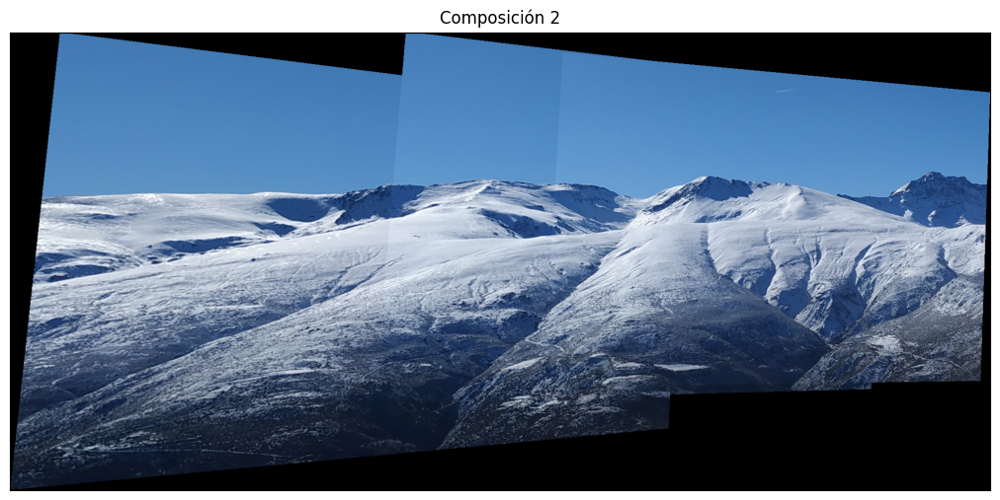

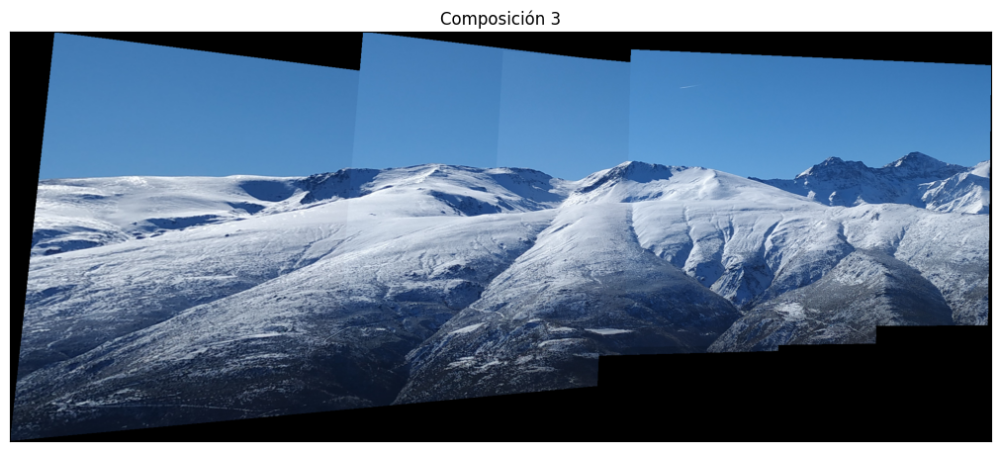

...

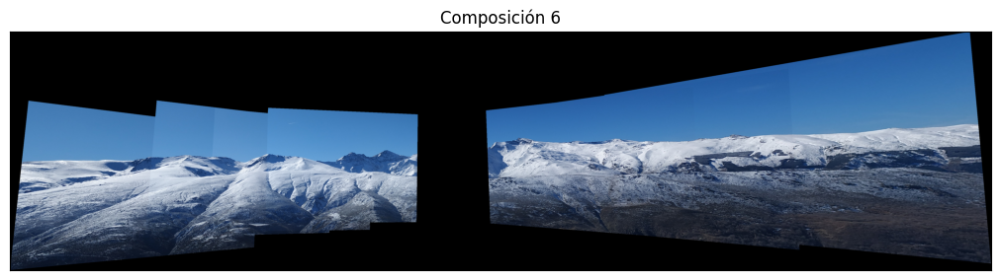

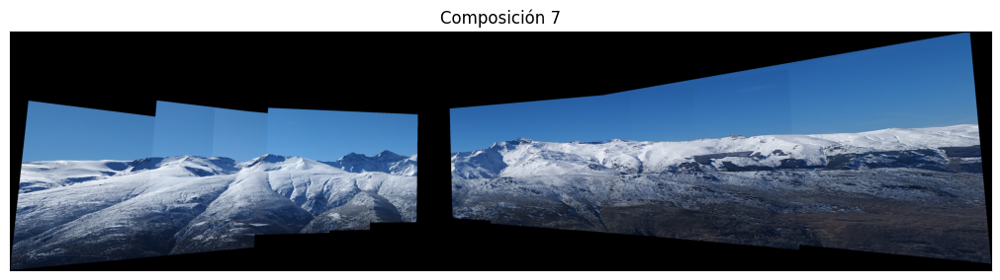

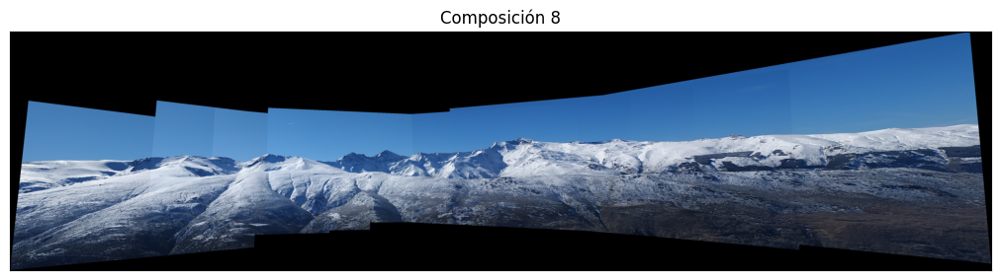

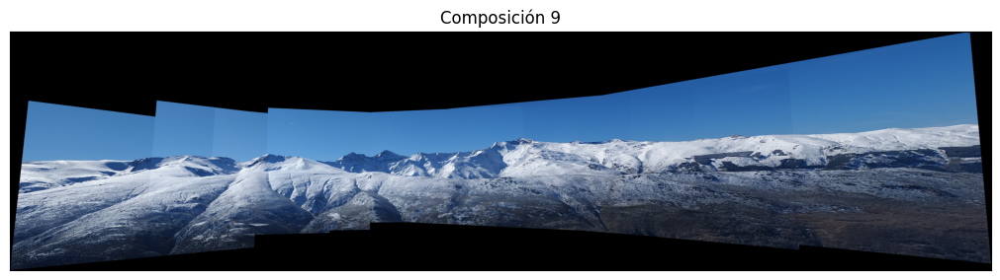

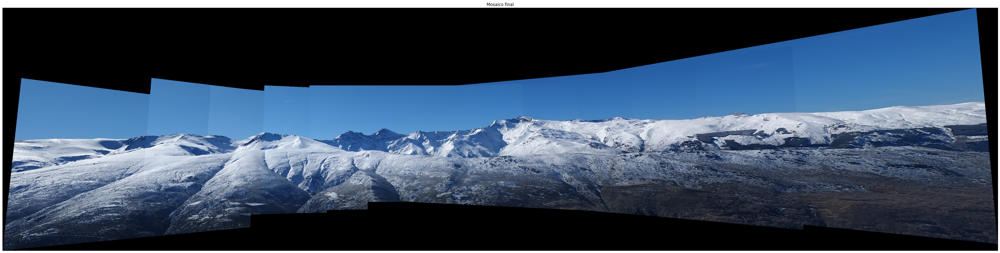

In [ ]:
# Calculamos dimensiones máximas, nim será el número de imágenes que usamos, 11
max_alto, max_ancho = 0, 0
for img in images:
        alto, ancho = img.shape[:2]
        max_alto = max(max_alto, alto)
        max_ancho = max(max_ancho, ancho)

H = computeLocalHomographies(images)
H = mosaicHomographies(H, 4)

canvas = setCanvas(max_alto, max_ancho, flagColor=True, nim=len(images))

H0 = axesHomography(images[4].shape[:2], canvas.shape[0:2])

displayIm(canvas, 'canvas', 8)

canvas_comp, mosaic = composeMosaic(images, canvas, H, 4, H0)

for i, im in enumerate(canvas_comp):
  displayIm(blackOut(im), f'Composición {i}')

displayIm(blackOut(mosaic), 'Mosaico final', 8)

#####**Comparación con cv2.Stitcher**

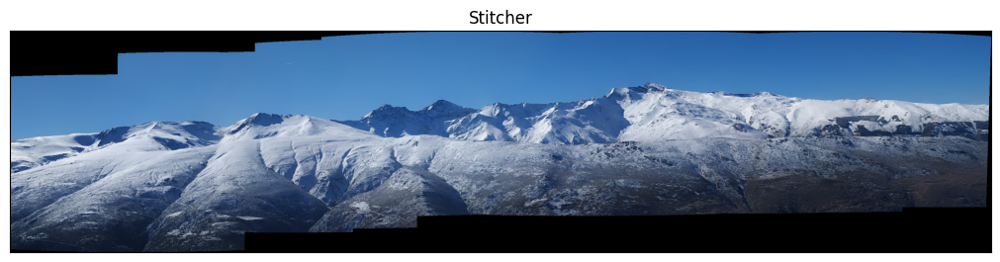

In [ ]:
stitcher = cv2.Stitcher_create()
_, stitched = stitcher.stitch(images)
displayIm(stitched, "Stitcher")